#### This notebook is created on Kaggle, you can import this notebook and run it there without having any trouble.

author: [@caesariodito](https://github.com/caesariodito)

In [25]:
from IPython.display import clear_output as cls

In [26]:
import zipfile

In [27]:
# download all model requirements

!pip install gdown

# lp detection model
# https://drive.google.com/file/d/1erWKTRIAZdp0KySoP9vFkVWY1r_27VmK/view?usp=sharing

# segmentation model
# https://drive.google.com/file/d/1bwBbtnQmR4Kw3vo9Q1ymwhXauDOLblod/view?usp=sharing

# character recognition model fixed
# https://drive.google.com/file/d/18qab2q_rVI9pjdJuCgEjobRH7arkp21Z/view?usp=sharing

!rm -r lp_detection
!gdown "https://drive.google.com/uc?id=1erWKTRIAZdp0KySoP9vFkVWY1r_27VmK" -O lp_detection.zip
# !unzip lp_detection.zip -d lp_detection
with zipfile.ZipFile('/kaggle/working/lp_detection.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/lp_detection')

!rm -r char_segmentation
!gdown "https://drive.google.com/uc?id=1bwBbtnQmR4Kw3vo9Q1ymwhXauDOLblod" -O char_segmentation.zip
# !unzip char_segmentation.zip -d char_segmentation
with zipfile.ZipFile('/kaggle/working/char_segmentation.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/char_segmentation')

!rm -r char_recognition
!gdown "https://drive.google.com/uc?id=18qab2q_rVI9pjdJuCgEjobRH7arkp21Z" -O char_recognition.zip
# !unzip char_recognition.zip -d char_recognition
with zipfile.ZipFile('/kaggle/working/char_recognition.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/char_recognition')

cls()

In [28]:
# data modified resized
# https://drive.google.com/file/d/1EbNVEPuRsujLmC52RGD-sz4-68HK45KH/view?usp=sharing

!rm -r dataset
!gdown "https://drive.google.com/uc?id=1EbNVEPuRsujLmC52RGD-sz4-68HK45KH" -O dataset.zip
# !unzip dataset.zip -d dataset
with zipfile.ZipFile('/kaggle/working/dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('/kaggle/working/dataset')

cls()

# Setup

In [29]:
%pip install ultralytics
%pip install roboflow

cls()

In [30]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.131 🚀 Python-3.10.10 torch-2.0.0+cpu CPU
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 4813.6/8062.4 GB disk)


In [31]:
import matplotlib.pyplot as plt

def plot_image(image):
    # Convert BGR image to RGB for plotting
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Plot the image
    plt.imshow(image)
    plt.axis('off')
    plt.show()


In [32]:
import matplotlib.pyplot as plt

def plot_images_horizontally(images):
    """Plots a list of images horizontally.
    
    Args:
        images (list): A list of images as numpy arrays.
    """
    n_images = len(images)
    fig, axes = plt.subplots(1, n_images)
    
    for i, image in enumerate(images):
        axes[i].imshow(image)
        axes[i].axis('off')
    
    plt.show()


In [33]:
import tensorflow as tf

HEIGHT_SIZE = 160
WIDTH_SIZE = 80

def load_and_preprocess_image(image, label=None):
    # Resize the image to the desired size
    image = tf.image.resize(image, [HEIGHT_SIZE, WIDTH_SIZE])
    
    # Convert image data type to tf.float32
    image = tf.cast(image, tf.float32)
    
    return image, label


In [34]:
from ultralytics import YOLO

lp_detect_path = '/kaggle/working/lp_detection/content/runs/detect/train/weights/best.pt'
segment_detect_path = '/kaggle/working/char_segmentation/best.pt'

lp_model = YOLO(lp_detect_path)
segment_model = YOLO(segment_detect_path)

In [35]:
from tensorflow.keras.models import load_model

cr_path = '/kaggle/working/char_recognition/character-recognition-alpr_xception_no_freeze_v1.h5'
cr_model = load_model(cr_path)

# Try Pipeline

In [36]:
img_test_path = '/kaggle/working/dataset/data-modified-resized/test/data/DataTest2.jpg'

# 1 IMAGE

## LP Localization


0: 96x256 1 lp, 43.8ms
Speed: 0.8ms preprocess, 43.8ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


ori image


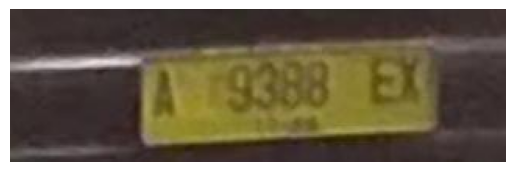

localized image


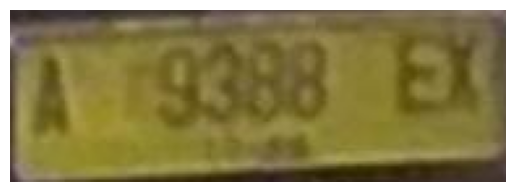

/kaggle/working/prediction/lp-localization/DataTest2.jpg


In [37]:
# license plate localization

import cv2
import os

image_paths_train = [img_test_path]
output_train_dir = '/kaggle/working/prediction/lp-localization/'

if not os.path.exists(output_train_dir):
    os.makedirs(output_train_dir)

# Run batched inference on a list of images
results = lp_model(image_paths_train)  # return a list of Results objects

# Process results list
for i, result in enumerate(results):
    box = result.boxes[0].xyxy[0]  # Boxes object for bbox outputs
    box = box.detach().cpu().numpy().astype(int)
    

    # Load the original image
    image = cv2.imread(image_paths_train[i])

    # Get the bounding box coordinates
    x1, y1, x2, y2 = box

    # Crop the image using the bounding box coordinates
    cropped_image = image[y1:y2, x1:x2]

    # Display the cropped image
    print('ori image')
    plot_image(image)
    print('localized image')
    plot_image(cropped_image)
    
    base_name = os.path.basename(image_paths_train[i])
    name, _ = os.path.splitext(base_name)
    
    output_path = os.path.join(output_train_dir, f'{name}.jpg')
    print(output_path)
    
    cv2.imwrite(output_path, cropped_image)

## Char Segmentation

In [38]:
img_localized = cropped_image.copy()

results = segment_model(img_localized)  # return a list of Results objects

# Get the bounding boxes for each detected object
boxes = results[0].boxes


0: 96x256 6 texts, 31.9ms
Speed: 0.8ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


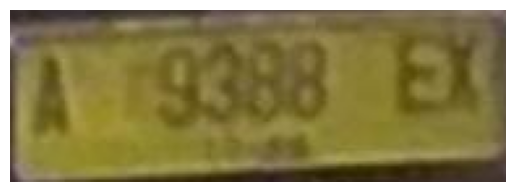

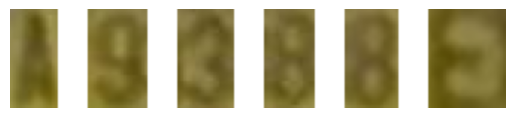

In [39]:
import numpy as np

tensor_boxes = boxes.xyxy
images = []
max_height = 0
space_width = 10 # Width of the space between images in pixels
space_color = (255, 255, 255) # Color of the space between images (white)

# Sort the tensor_boxes by their x-coordinates
tensor_boxes = sorted(tensor_boxes, key=lambda box: box[0])

for box in tensor_boxes:
    box = box.detach().cpu().numpy().astype(int)
    # Load the original image
#     image_ori = cv2.imread(img_localized)

    # Get the bounding box coordinates
    x1, y1, x2, y2 = box

    # Crop the image using the bounding box coordinates
    cropped_image = img_localized[y1:y2, x1:x2]
    
    # Get the height of the cropped image
    height, _, _ = cropped_image.shape
    
    # Update the maximum height
    max_height = max(max_height, height)
    
    # Append the cropped image to the list of images
    images.append(cropped_image)

# Create an empty image for the space between images
space_image = np.zeros((max_height, space_width, 3), dtype=np.uint8)
space_image[:] = space_color

# Resize all images to have the same height and add space between them
resized_images = []
for image in images:
    resized_image = cv2.resize(image, (int(image.shape[1] * max_height / image.shape[0]), max_height))
    resized_images.append(resized_image)
    resized_images.append(space_image)

# Remove the last space image
resized_images.pop()

# Stack the images horizontally
stacked_images = np.hstack(resized_images)

plot_image(img_localized)

# Display the stacked images
plot_image(stacked_images)

## Character Recognition

In [40]:
len(images)

6

In [41]:
type(images[0])

numpy.ndarray

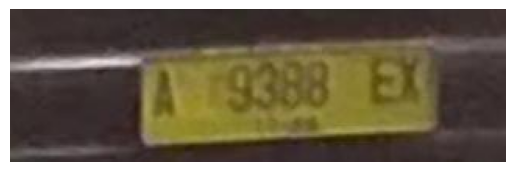

final answer: A9388E


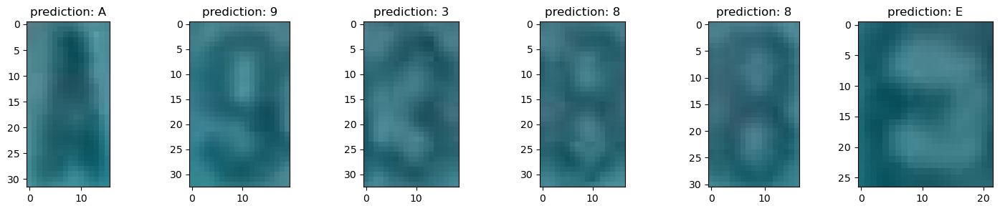

In [42]:
import matplotlib.pyplot as plt

class_names = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']

image_raw = cv2.imread(img_test_path)
plot_image(image_raw)

n_images = len(images)
fig, axes = plt.subplots(1, n_images, figsize=(n_images * 3, 3))

answer = ''

for i, image in enumerate(images):
    image_tf = tf.convert_to_tensor(image)
    image_tf, _ = load_and_preprocess_image(image_tf)
    
    # Expand the first dimension of the image tensor to create a batch of size 1
    image_tf = tf.expand_dims(image_tf, axis=0)

    # Make a prediction
    prediction = cr_model.predict(image_tf, verbose=0)
    result = class_names[np.argmax(prediction)]
    
    answer += result
    
    axes[i].imshow(image)
    axes[i].set_title(f'prediction: {result}')

print(f'final answer: {answer}')

# All Image

total data:  100


0: 256x256 1 lp, 1: 256x256 1 lp, 2: 256x256 1 lp, 3: 256x256 1 lp, 4: 256x256 1 lp, 5: 256x256 1 lp, 6: 256x256 1 lp, 7: 256x256 1 lp, 8: 256x256 1 lp, 9: 256x256 1 lp, 10: 256x256 1 lp, 11: 256x256 1 lp, 12: 256x256 1 lp, 13: 256x256 1 lp, 14: 256x256 1 lp, 15: 256x256 1 lp, 16: 256x256 1 lp, 17: 256x256 1 lp, 18: 256x256 1 lp, 19: 256x256 1 lp, 20: 256x256 1 lp, 21: 256x256 2 lps, 22: 256x256 1 lp, 23: 256x256 1 lp, 24: 256x256 1 lp, 25: 256x256 1 lp, 26: 256x256 1 lp, 27: 256x256 1 lp, 28: 256x256 1 lp, 29: 256x256 1 lp, 30: 256x256 1 lp, 31: 256x256 1 lp, 32: 256x256 1 lp, 33: 256x256 1 lp, 34: 256x256 1 lp, 35: 256x256 1 lp, 36: 256x256 1 lp, 37: 256x256 1 lp, 38: 256x256 1 lp, 39: 256x256 1 lp, 40: 256x256 1 lp, 41: 256x256 1 lp, 42: 256x256 1 lp, 43: 256x256 1 lp, 44: 256x256 1 lp, 45: 256x256 1 lp, 46: 256x256 1 lp, 47: 256x256 1 lp, 48: 256x256 1 lp, 49: 256x256 1 lp, 50: 256x256 1 lp, 51: 256x256 1 lp, 52: 256x256 1 lp, 53: 256x256 1 lp, 54: 256x256 1 lp, 55: 256x256 1 lp, 5

PREDICTING IMAGE-0 ==========
ori image


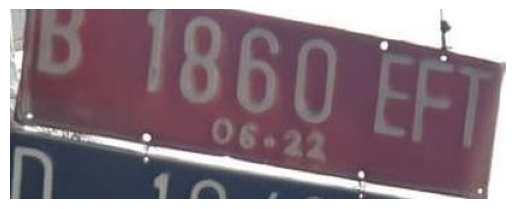

localized image


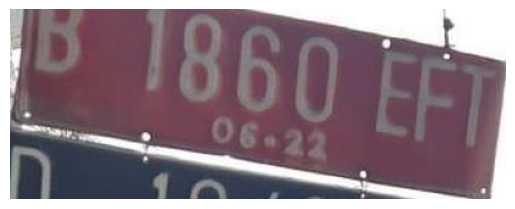


0: 128x256 8 texts, 50.8ms
Speed: 1.0ms preprocess, 50.8ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


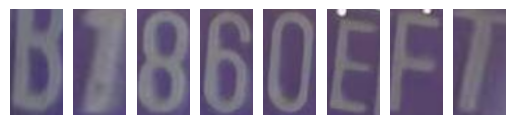

final answer: B1860EFT
END OF IMAGE-0 ========== 



PREDICTING IMAGE-1 ==========
ori image


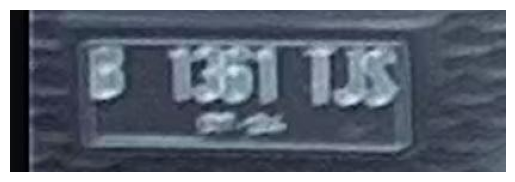

localized image


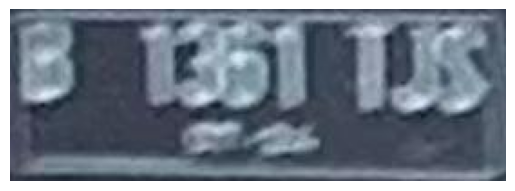


0: 96x256 8 texts, 45.0ms
Speed: 5.1ms preprocess, 45.0ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


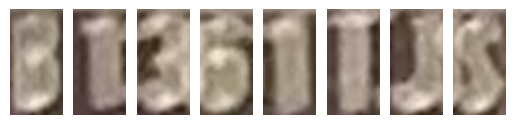

final answer: B1361TJS
END OF IMAGE-1 ========== 



PREDICTING IMAGE-2 ==========
ori image


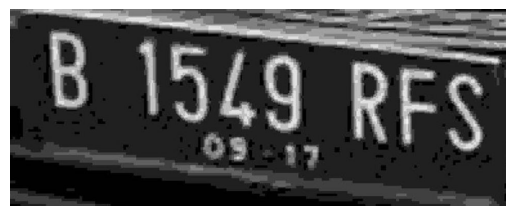

localized image


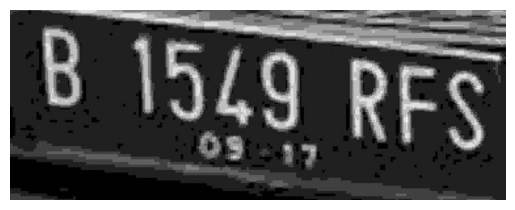


0: 128x256 8 texts, 48.7ms
Speed: 1.3ms preprocess, 48.7ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


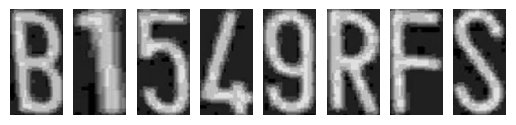

final answer: B1549RFS
END OF IMAGE-2 ========== 



PREDICTING IMAGE-3 ==========
ori image


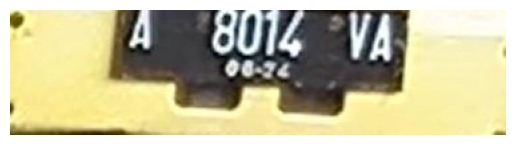

localized image


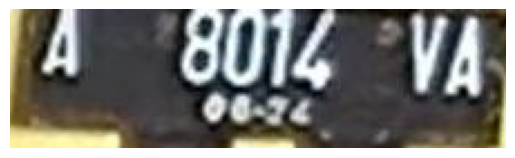


0: 96x256 6 texts, 45.2ms
Speed: 0.7ms preprocess, 45.2ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


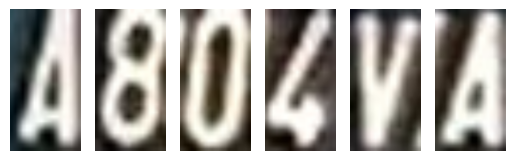

final answer: A804VA
END OF IMAGE-3 ========== 



PREDICTING IMAGE-4 ==========
ori image


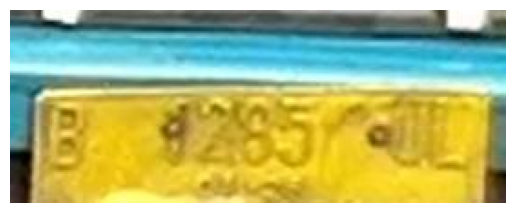

localized image


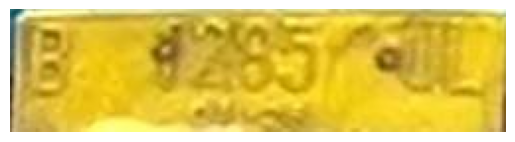


0: 64x256 6 texts, 46.3ms
Speed: 0.7ms preprocess, 46.3ms inference, 0.7ms postprocess per image at shape (1, 3, 64, 256)


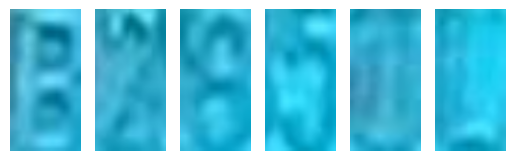

final answer: F28W22
END OF IMAGE-4 ========== 



PREDICTING IMAGE-5 ==========
ori image


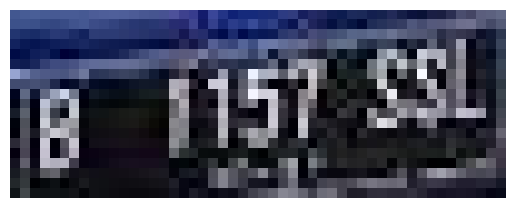

localized image


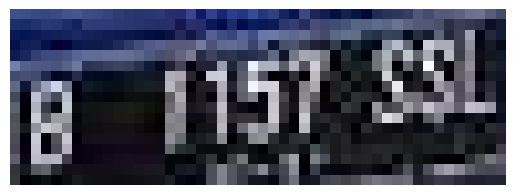


0: 96x256 8 texts, 50.1ms
Speed: 4.9ms preprocess, 50.1ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


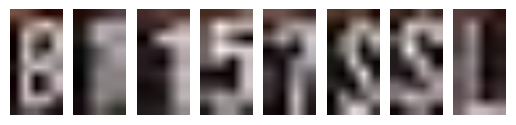

final answer: B1151SSI
END OF IMAGE-5 ========== 



PREDICTING IMAGE-6 ==========
ori image


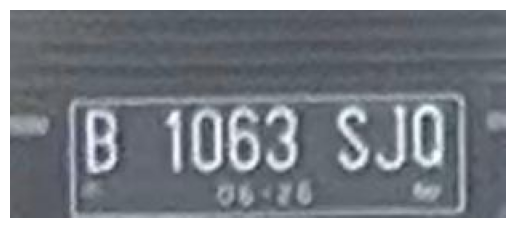

localized image


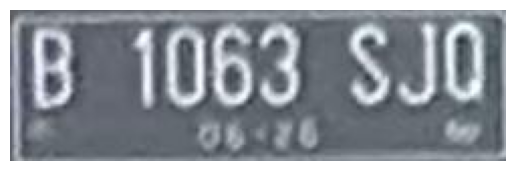


0: 96x256 8 texts, 55.1ms
Speed: 0.7ms preprocess, 55.1ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


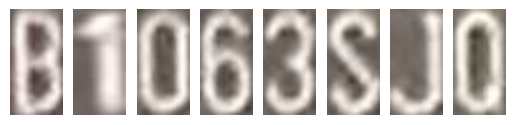

final answer: B1063SJQ
END OF IMAGE-6 ========== 



PREDICTING IMAGE-7 ==========
ori image


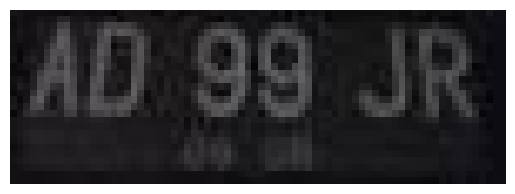

localized image


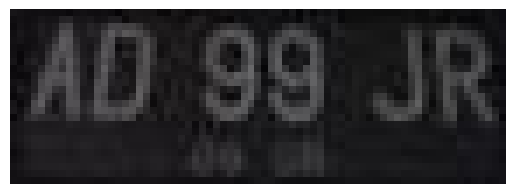


0: 96x256 6 texts, 50.5ms
Speed: 6.1ms preprocess, 50.5ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


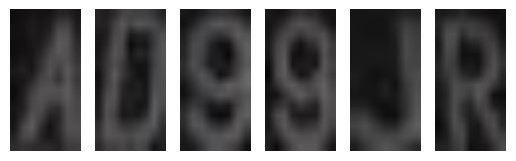

final answer: AD99JR
END OF IMAGE-7 ========== 



PREDICTING IMAGE-8 ==========
ori image


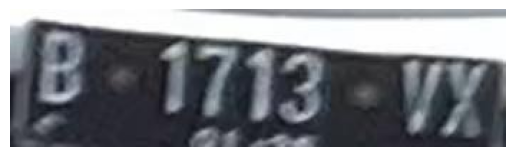

localized image


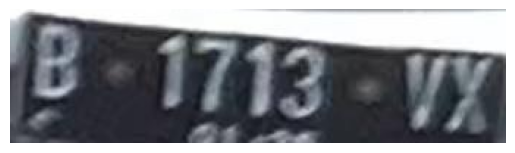


0: 96x256 7 texts, 54.5ms
Speed: 6.6ms preprocess, 54.5ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


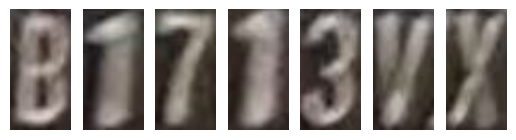

final answer: B1713VX
END OF IMAGE-8 ========== 



PREDICTING IMAGE-9 ==========
ori image


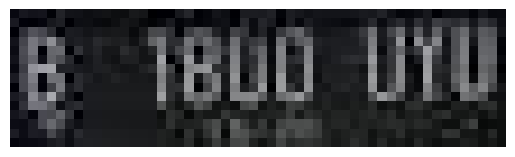

localized image


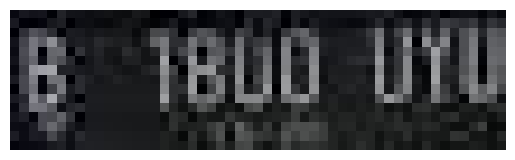


0: 96x256 8 texts, 52.6ms
Speed: 4.6ms preprocess, 52.6ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


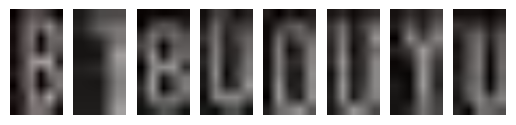

final answer: B18UDU1U
END OF IMAGE-9 ========== 



PREDICTING IMAGE-10 ==========
ori image


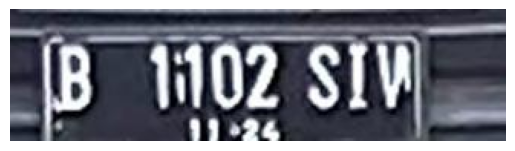

localized image


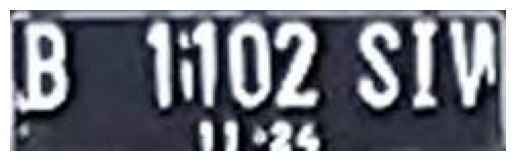


0: 96x256 9 texts, 50.6ms
Speed: 7.6ms preprocess, 50.6ms inference, 1.0ms postprocess per image at shape (1, 3, 96, 256)


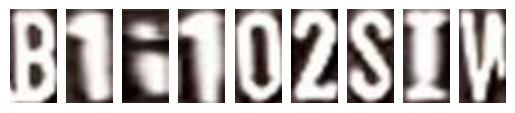

final answer: B11102SIV
END OF IMAGE-10 ========== 



PREDICTING IMAGE-11 ==========
ori image


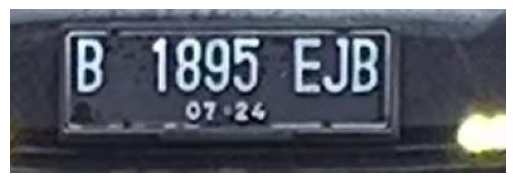

localized image


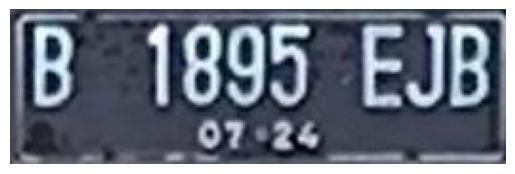


0: 96x256 8 texts, 44.0ms
Speed: 8.5ms preprocess, 44.0ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


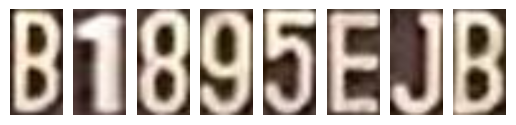

final answer: B1895EJB
END OF IMAGE-11 ========== 



PREDICTING IMAGE-12 ==========
ori image


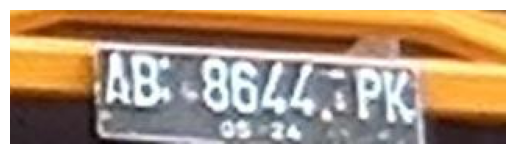

localized image


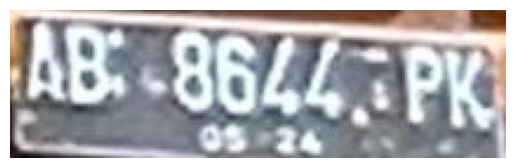


0: 96x256 8 texts, 40.5ms
Speed: 1.3ms preprocess, 40.5ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


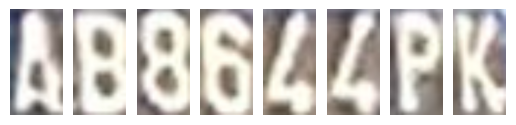

final answer: AB8644PK
END OF IMAGE-12 ========== 



PREDICTING IMAGE-13 ==========
ori image


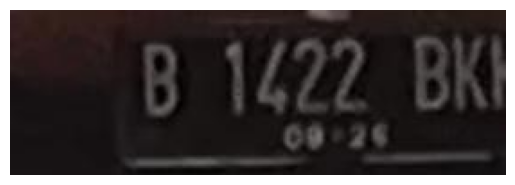

localized image


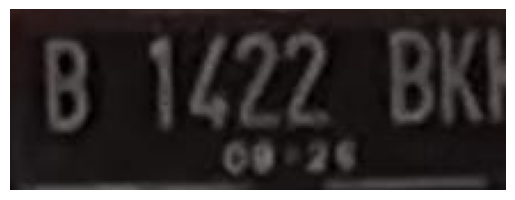


0: 96x256 8 texts, 51.1ms
Speed: 0.6ms preprocess, 51.1ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


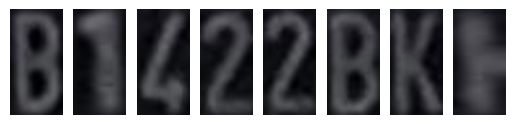

final answer: B1422BK1
END OF IMAGE-13 ========== 



PREDICTING IMAGE-14 ==========
ori image


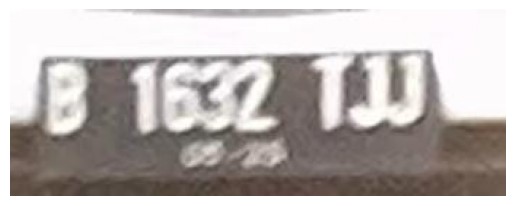

localized image


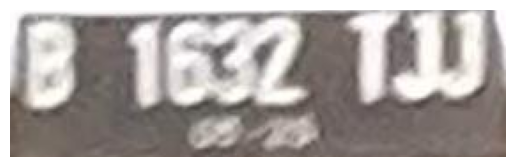


0: 96x256 9 texts, 48.9ms
Speed: 5.5ms preprocess, 48.9ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


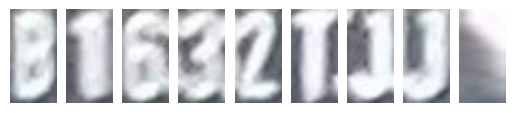

final answer: B1632TJJ1
END OF IMAGE-14 ========== 



PREDICTING IMAGE-15 ==========
ori image


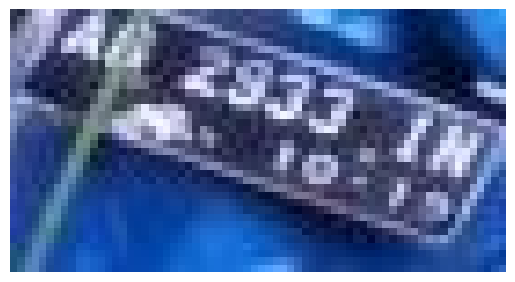

localized image


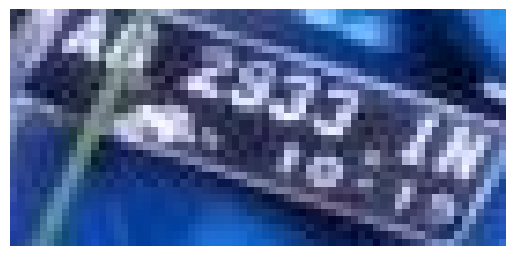


0: 128x256 8 texts, 66.9ms
Speed: 4.5ms preprocess, 66.9ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


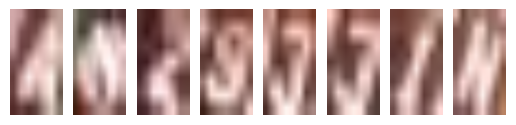

final answer: ANK355IW
END OF IMAGE-15 ========== 



PREDICTING IMAGE-16 ==========
ori image


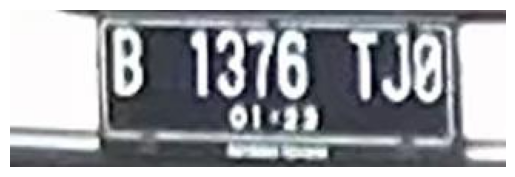

localized image


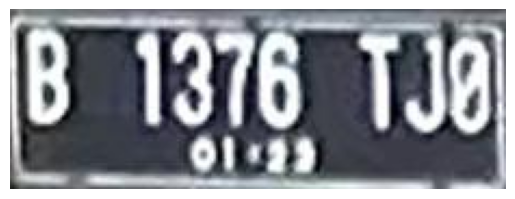


0: 96x256 8 texts, 42.8ms
Speed: 7.3ms preprocess, 42.8ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


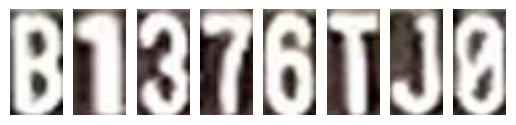

final answer: B1376TJO
END OF IMAGE-16 ========== 



PREDICTING IMAGE-17 ==========
ori image


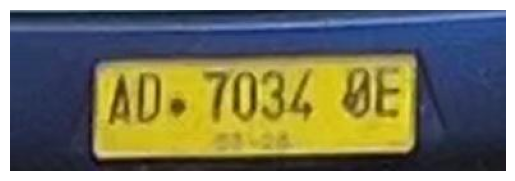

localized image


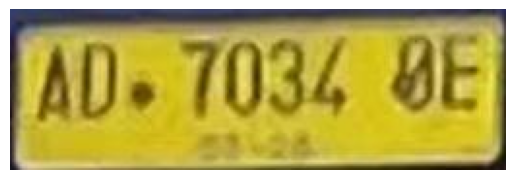


0: 96x256 8 texts, 32.4ms
Speed: 8.6ms preprocess, 32.4ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


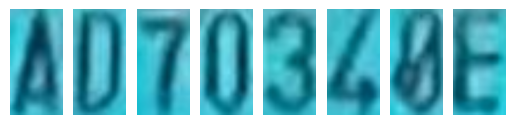

final answer: AD7034OE
END OF IMAGE-17 ========== 



PREDICTING IMAGE-18 ==========
ori image


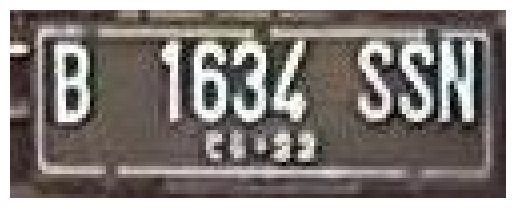

localized image


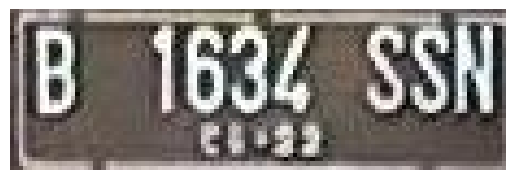


0: 96x256 8 texts, 51.3ms
Speed: 5.1ms preprocess, 51.3ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


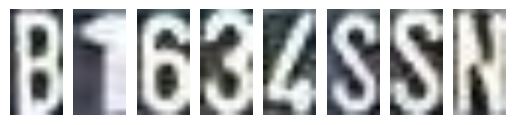

final answer: B1634SSN
END OF IMAGE-18 ========== 



PREDICTING IMAGE-19 ==========
ori image


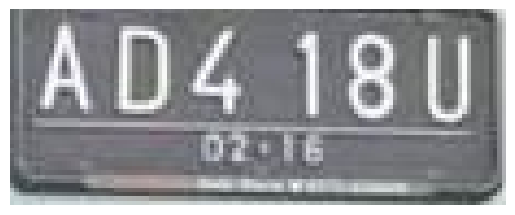

localized image


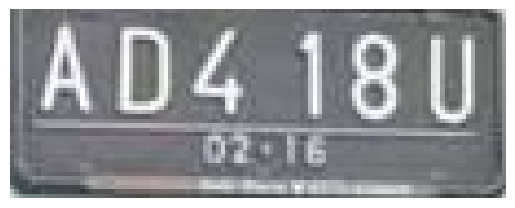


0: 128x256 6 texts, 75.3ms
Speed: 1.1ms preprocess, 75.3ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


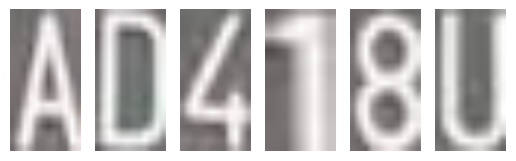

final answer: AD418U
END OF IMAGE-19 ========== 



PREDICTING IMAGE-20 ==========
ori image


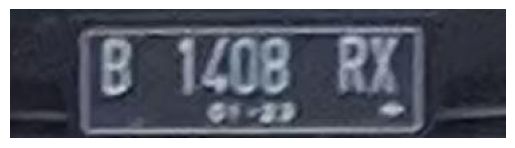

localized image


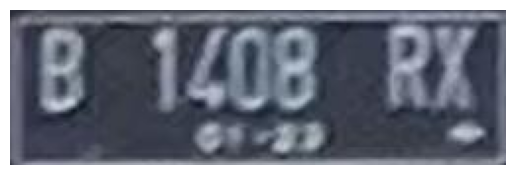


0: 96x256 7 texts, 50.5ms
Speed: 0.7ms preprocess, 50.5ms inference, 1.2ms postprocess per image at shape (1, 3, 96, 256)


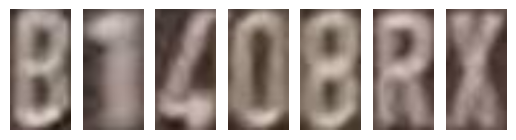

final answer: B1408RX
END OF IMAGE-20 ========== 



PREDICTING IMAGE-21 ==========
ori image


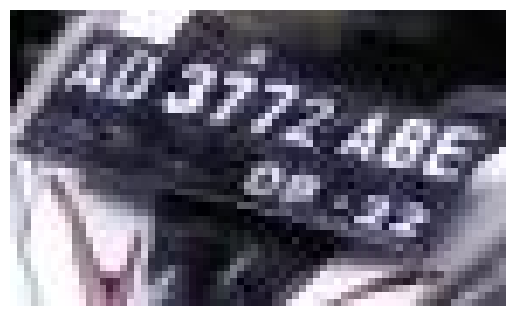

localized image


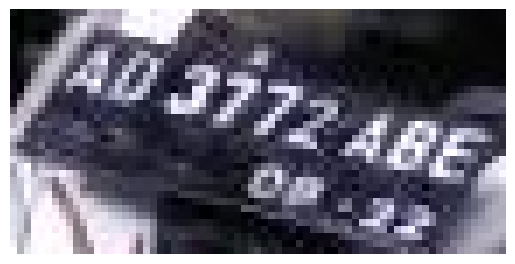


0: 128x256 10 texts, 64.5ms
Speed: 6.0ms preprocess, 64.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


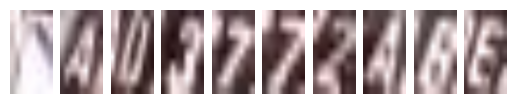

final answer: KAU3172ABE
END OF IMAGE-21 ========== 



PREDICTING IMAGE-22 ==========
ori image


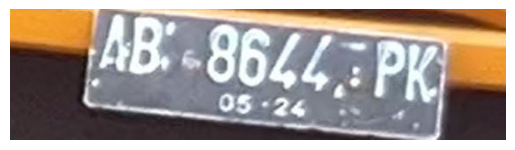

localized image


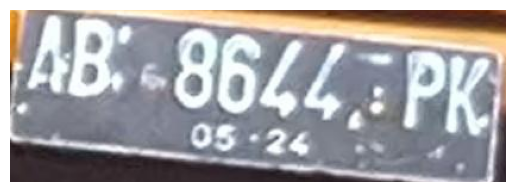


0: 96x256 8 texts, 34.3ms
Speed: 10.7ms preprocess, 34.3ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


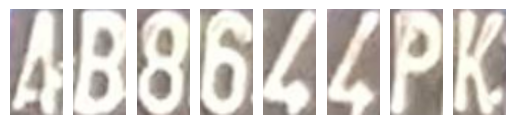

final answer: AB8644PK
END OF IMAGE-22 ========== 



PREDICTING IMAGE-23 ==========
ori image


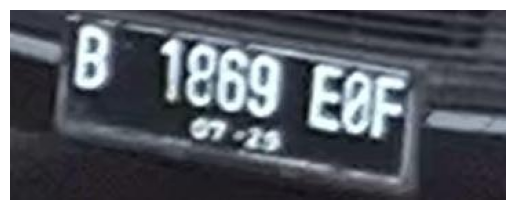

localized image


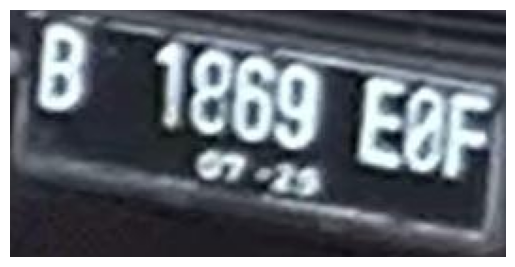


0: 128x256 8 texts, 48.2ms
Speed: 1.0ms preprocess, 48.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


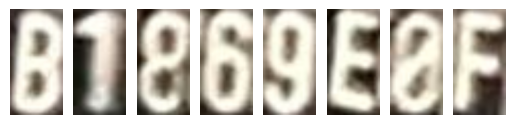

final answer: B1869EOF
END OF IMAGE-23 ========== 



PREDICTING IMAGE-24 ==========
ori image


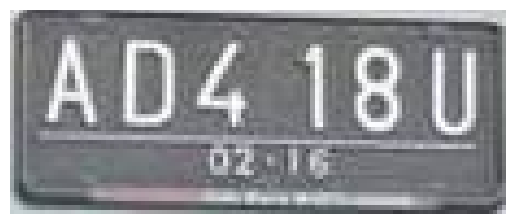

localized image


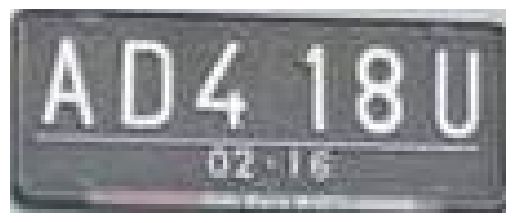


0: 128x256 6 texts, 63.8ms
Speed: 1.0ms preprocess, 63.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


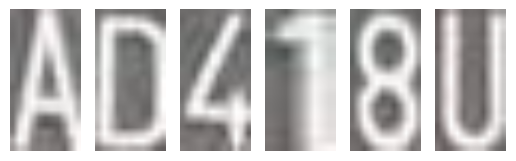

final answer: AD418U
END OF IMAGE-24 ========== 



PREDICTING IMAGE-25 ==========
ori image


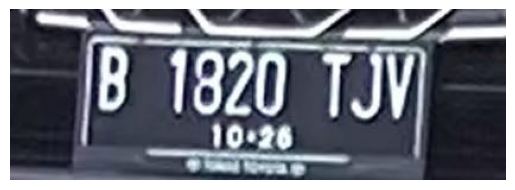

localized image


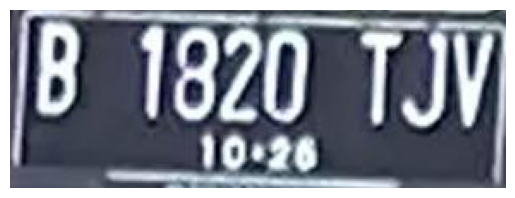


0: 96x256 8 texts, 48.4ms
Speed: 7.2ms preprocess, 48.4ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


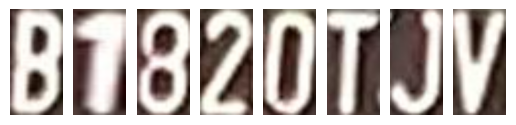

final answer: B1820TJV
END OF IMAGE-25 ========== 



PREDICTING IMAGE-26 ==========
ori image


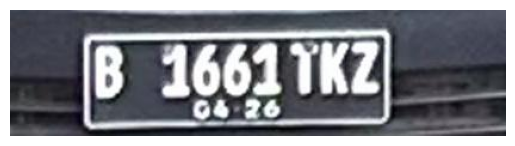

localized image


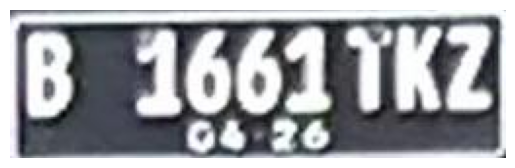


0: 96x256 8 texts, 51.3ms
Speed: 0.7ms preprocess, 51.3ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


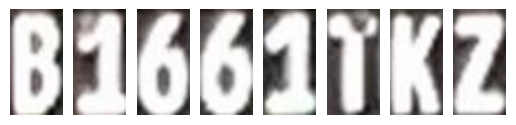

final answer: B1661TKZ
END OF IMAGE-26 ========== 



PREDICTING IMAGE-27 ==========
ori image


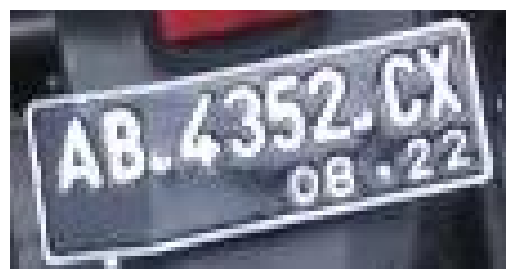

localized image


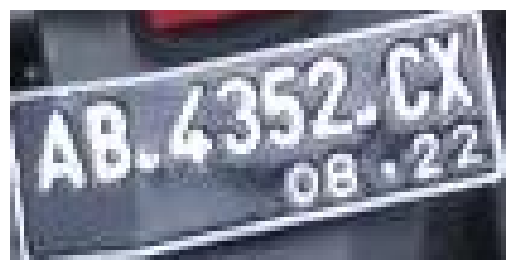


0: 160x256 8 texts, 86.3ms
Speed: 6.3ms preprocess, 86.3ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 256)


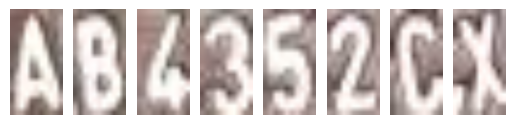

final answer: A84352CX
END OF IMAGE-27 ========== 



PREDICTING IMAGE-28 ==========
ori image


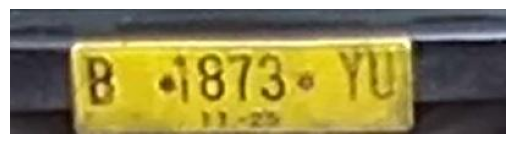

localized image


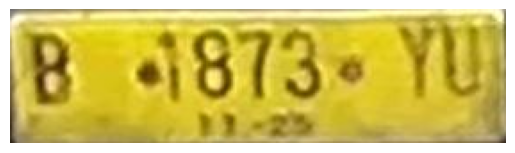


0: 96x256 7 texts, 47.5ms
Speed: 0.7ms preprocess, 47.5ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


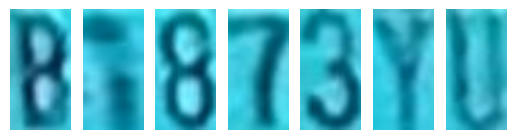

final answer: B1873YU
END OF IMAGE-28 ========== 



PREDICTING IMAGE-29 ==========
ori image


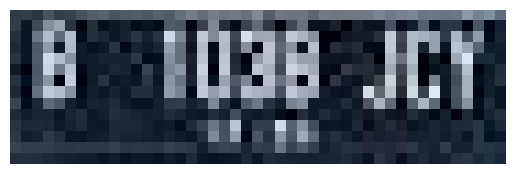

localized image


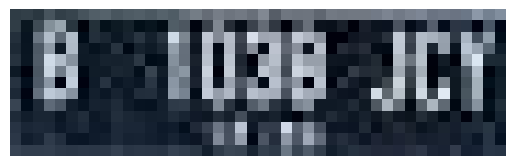


0: 96x256 9 texts, 46.6ms
Speed: 4.7ms preprocess, 46.6ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


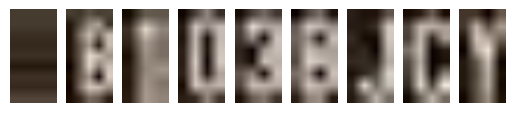

final answer: CB1Q38IC1
END OF IMAGE-29 ========== 



PREDICTING IMAGE-30 ==========
ori image


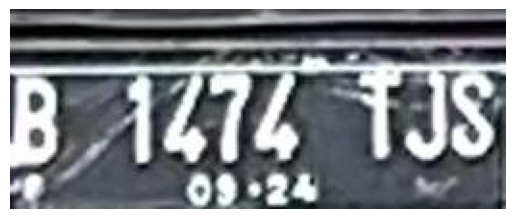

localized image


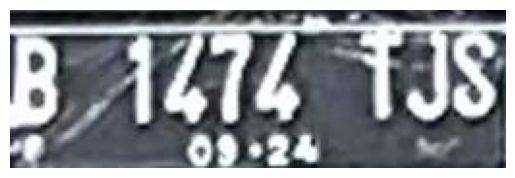


0: 96x256 8 texts, 46.7ms
Speed: 0.6ms preprocess, 46.7ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


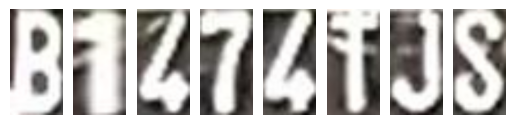

final answer: B1474TJS
END OF IMAGE-30 ========== 



PREDICTING IMAGE-31 ==========
ori image


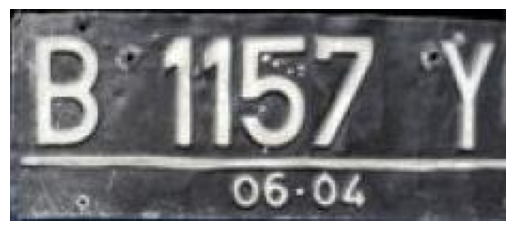

localized image


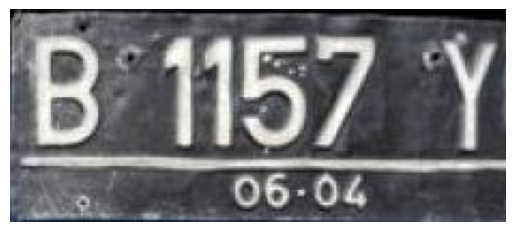


0: 128x256 6 texts, 58.1ms
Speed: 7.2ms preprocess, 58.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


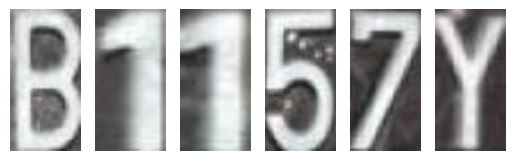

final answer: B1157Y
END OF IMAGE-31 ========== 



PREDICTING IMAGE-32 ==========
ori image


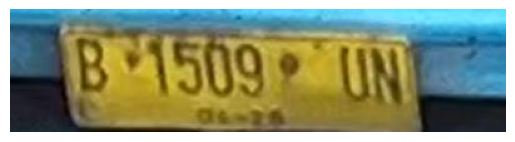

localized image


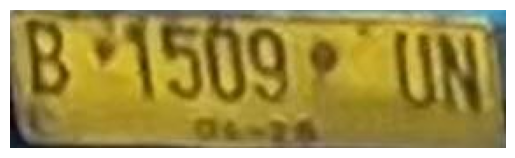


0: 96x256 7 texts, 48.9ms
Speed: 0.6ms preprocess, 48.9ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


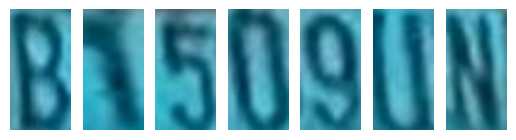

final answer: B1509UN
END OF IMAGE-32 ========== 



PREDICTING IMAGE-33 ==========
ori image


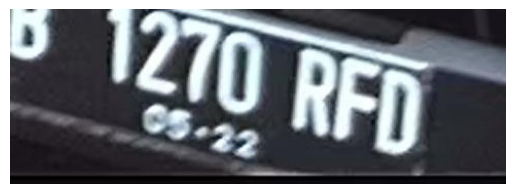

localized image


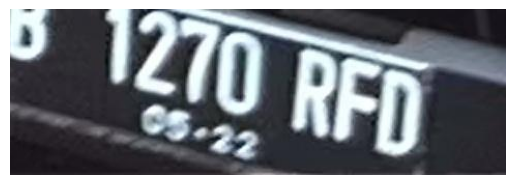


0: 96x256 8 texts, 43.6ms
Speed: 5.1ms preprocess, 43.6ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


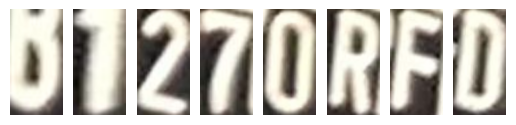

final answer: B1270RFD
END OF IMAGE-33 ========== 



PREDICTING IMAGE-34 ==========
ori image


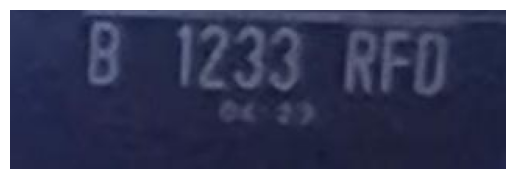

localized image


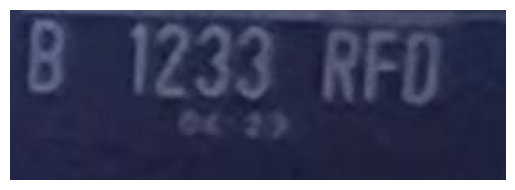


0: 96x256 8 texts, 58.1ms
Speed: 2.0ms preprocess, 58.1ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


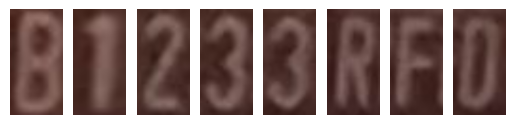

final answer: B1233RFD
END OF IMAGE-34 ========== 



PREDICTING IMAGE-35 ==========
ori image


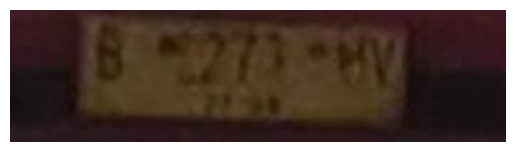

localized image


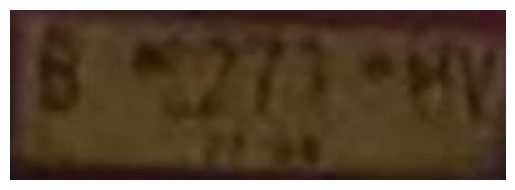


0: 96x256 9 texts, 69.8ms
Speed: 0.8ms preprocess, 69.8ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


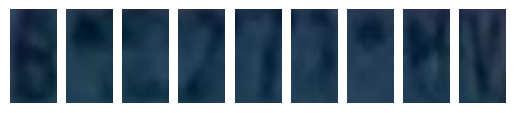

final answer: O22722200
END OF IMAGE-35 ========== 



PREDICTING IMAGE-36 ==========
ori image


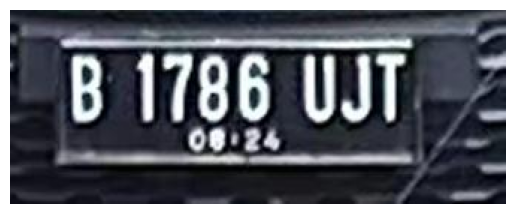

localized image


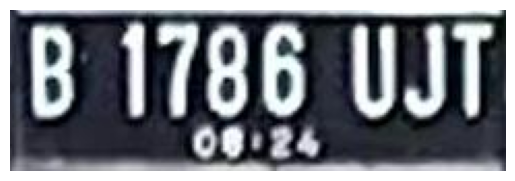


0: 96x256 8 texts, 48.0ms
Speed: 1.2ms preprocess, 48.0ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


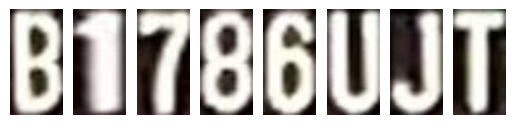

final answer: B1786UJT
END OF IMAGE-36 ========== 



PREDICTING IMAGE-37 ==========
ori image


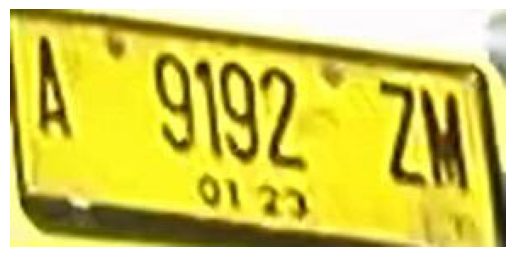

localized image


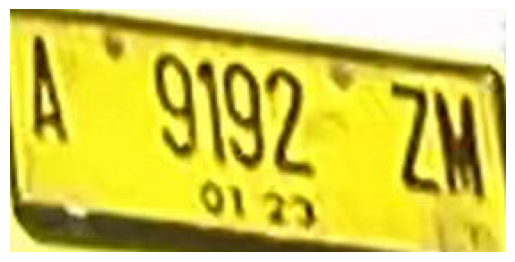


0: 128x256 7 texts, 38.7ms
Speed: 4.0ms preprocess, 38.7ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


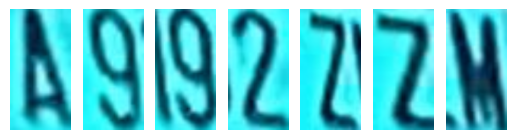

final answer: A992Z2M
END OF IMAGE-37 ========== 



PREDICTING IMAGE-38 ==========
ori image


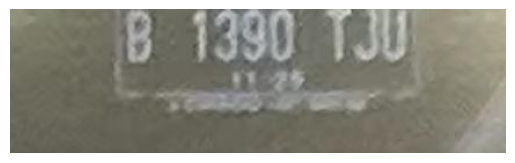

localized image


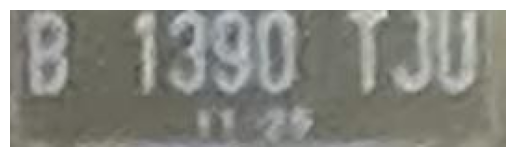


0: 96x256 8 texts, 50.4ms
Speed: 7.9ms preprocess, 50.4ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


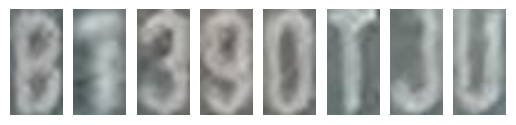

final answer: B1390TJU
END OF IMAGE-38 ========== 



PREDICTING IMAGE-39 ==========
ori image


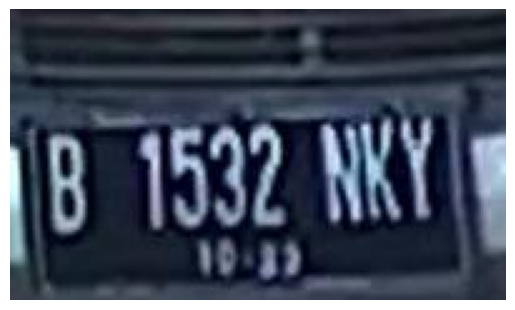

localized image


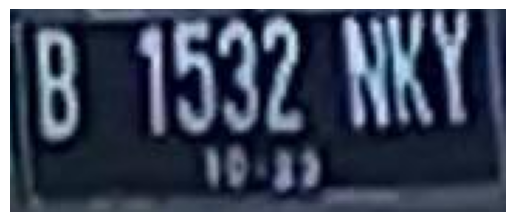


0: 128x256 8 texts, 47.1ms
Speed: 1.0ms preprocess, 47.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


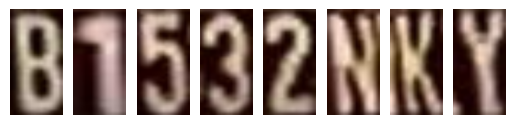

final answer: B1532NKY
END OF IMAGE-39 ========== 



PREDICTING IMAGE-40 ==========
ori image


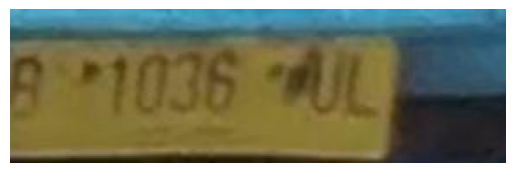

localized image


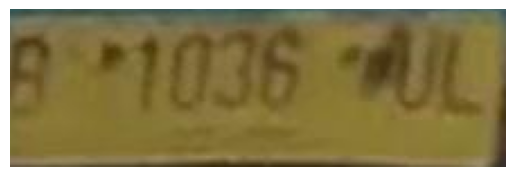


0: 96x256 8 texts, 44.8ms
Speed: 0.7ms preprocess, 44.8ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


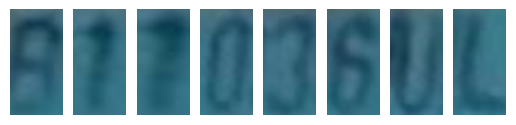

final answer: 81100BUL
END OF IMAGE-40 ========== 



PREDICTING IMAGE-41 ==========
ori image


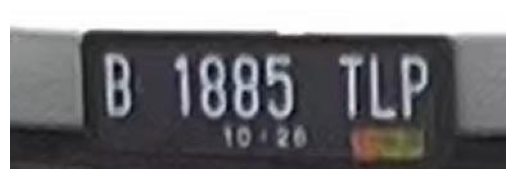

localized image


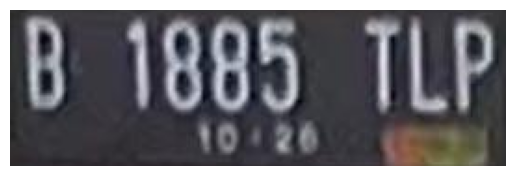


0: 96x256 8 texts, 46.2ms
Speed: 0.7ms preprocess, 46.2ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


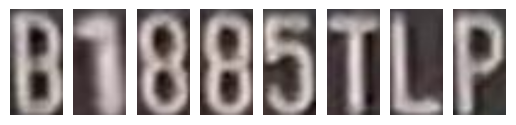

final answer: B1885TLP
END OF IMAGE-41 ========== 



PREDICTING IMAGE-42 ==========
ori image


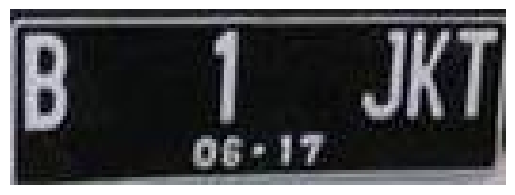

localized image


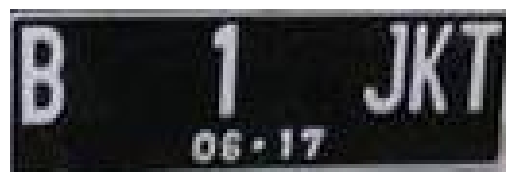


0: 96x256 5 texts, 47.0ms
Speed: 0.6ms preprocess, 47.0ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


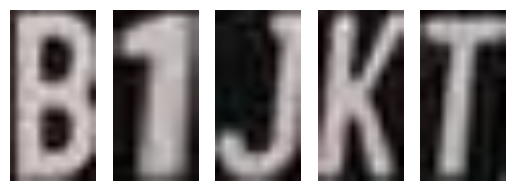

final answer: B1JKT
END OF IMAGE-42 ========== 



PREDICTING IMAGE-43 ==========
ori image


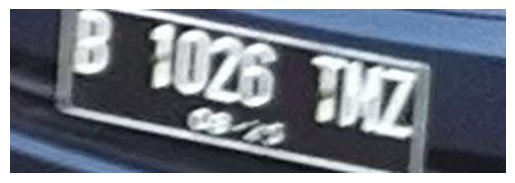

localized image


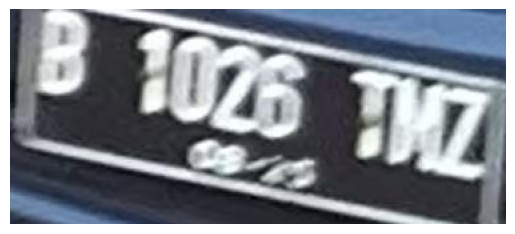


0: 128x256 8 texts, 41.8ms
Speed: 1.0ms preprocess, 41.8ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


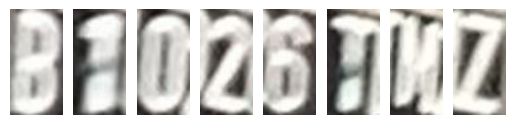

final answer: B1026TMZ
END OF IMAGE-43 ========== 



PREDICTING IMAGE-44 ==========
ori image


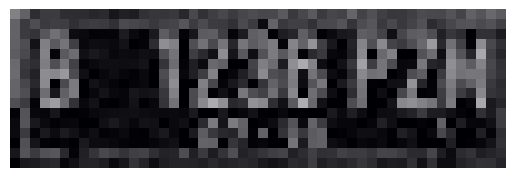

localized image


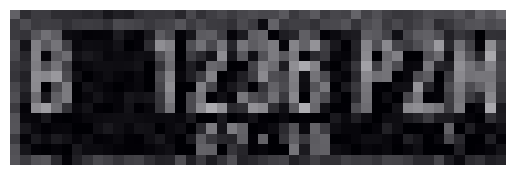


0: 96x256 8 texts, 49.9ms
Speed: 1.0ms preprocess, 49.9ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


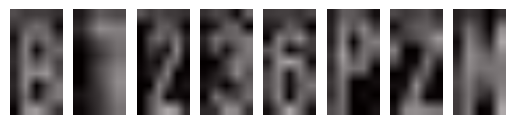

final answer: A1236P2M
END OF IMAGE-44 ========== 



PREDICTING IMAGE-45 ==========
ori image


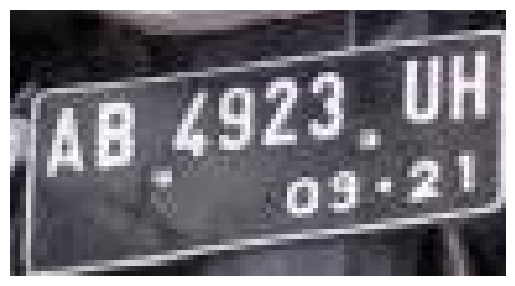

localized image


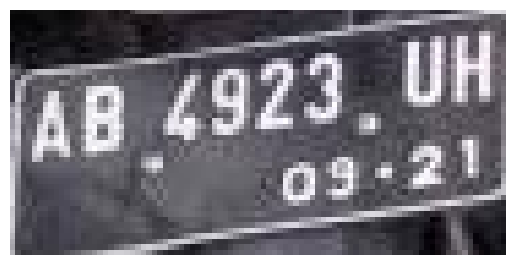


0: 128x256 8 texts, 58.4ms
Speed: 0.7ms preprocess, 58.4ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


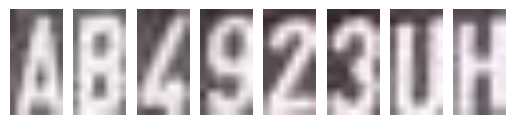

final answer: AB4923UH
END OF IMAGE-45 ========== 



PREDICTING IMAGE-46 ==========
ori image


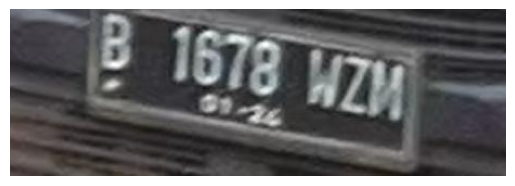

localized image


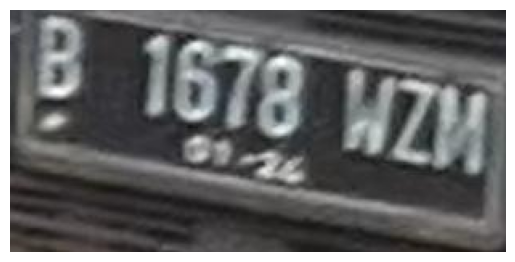


0: 128x256 8 texts, 48.8ms
Speed: 1.2ms preprocess, 48.8ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


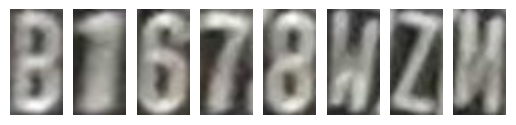

final answer: B1678WZN
END OF IMAGE-46 ========== 



PREDICTING IMAGE-47 ==========
ori image


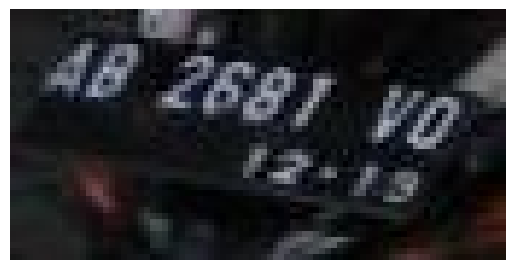

localized image


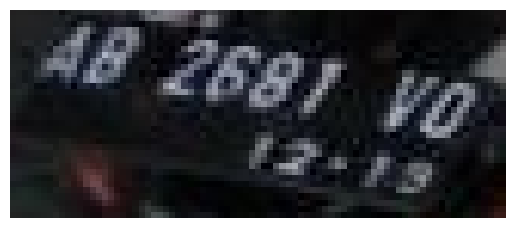


0: 128x256 8 texts, 67.8ms
Speed: 1.1ms preprocess, 67.8ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


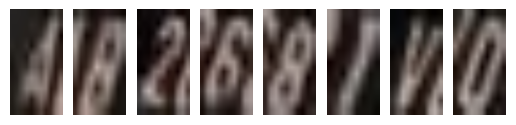

final answer: AB2687VD
END OF IMAGE-47 ========== 



PREDICTING IMAGE-48 ==========
ori image


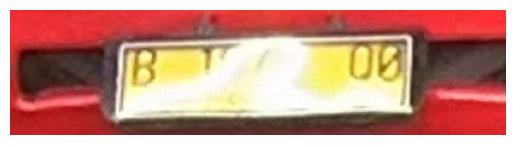

localized image


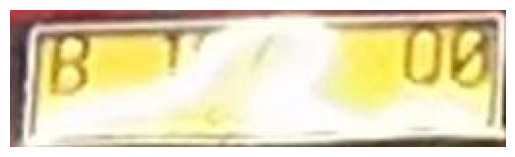


0: 96x256 4 texts, 47.0ms
Speed: 8.3ms preprocess, 47.0ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


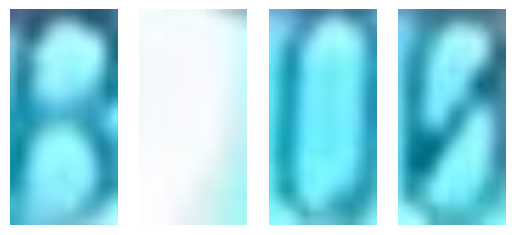

final answer: 8102
END OF IMAGE-48 ========== 



PREDICTING IMAGE-49 ==========
ori image


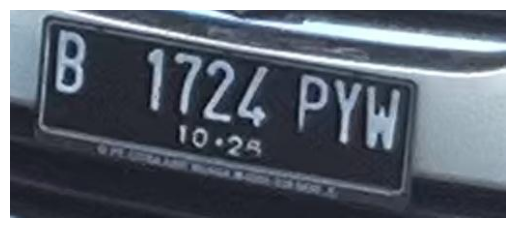

localized image


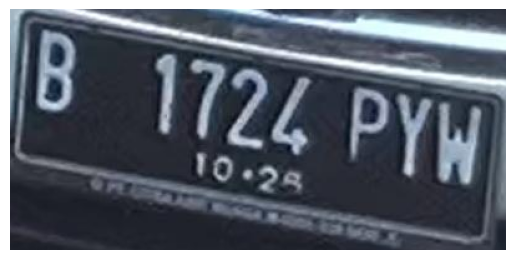


0: 128x256 8 texts, 45.7ms
Speed: 1.5ms preprocess, 45.7ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


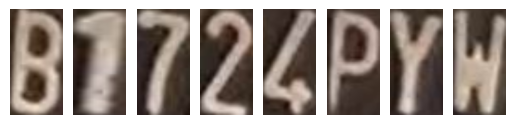

final answer: B1724PYW
END OF IMAGE-49 ========== 



PREDICTING IMAGE-50 ==========
ori image


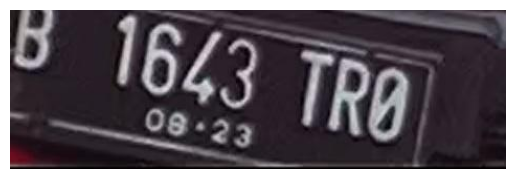

localized image


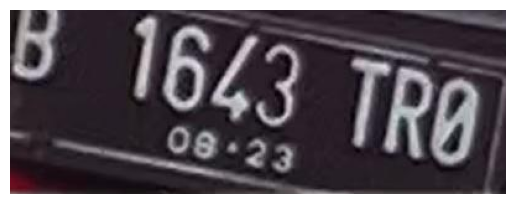


0: 96x256 8 texts, 50.9ms
Speed: 0.8ms preprocess, 50.9ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


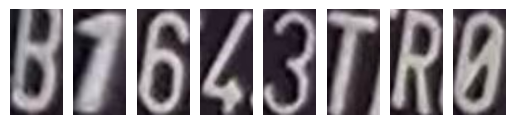

final answer: B1643TRO
END OF IMAGE-50 ========== 



PREDICTING IMAGE-51 ==========
ori image


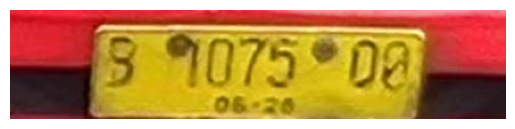

localized image


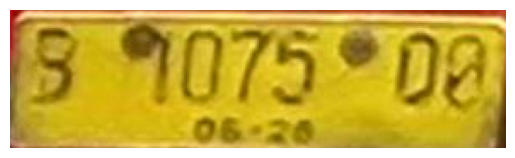


0: 96x256 7 texts, 38.8ms
Speed: 0.7ms preprocess, 38.8ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


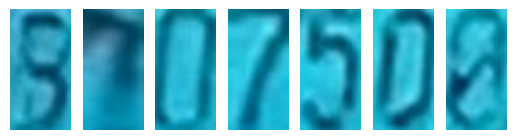

final answer: 9107502
END OF IMAGE-51 ========== 



PREDICTING IMAGE-52 ==========
ori image


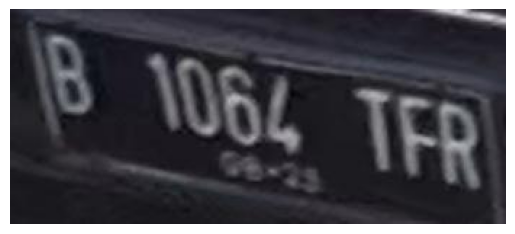

localized image


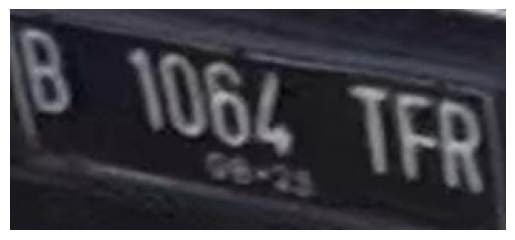


0: 128x256 8 texts, 62.2ms
Speed: 1.2ms preprocess, 62.2ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


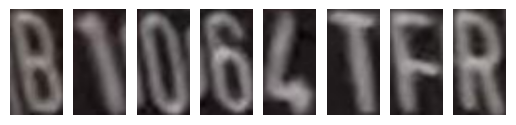

final answer: B1064TFR
END OF IMAGE-52 ========== 



PREDICTING IMAGE-53 ==========
ori image


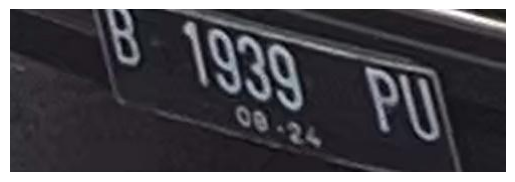

localized image


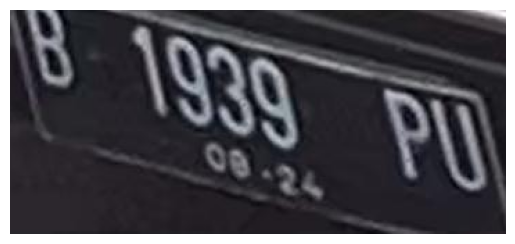


0: 128x256 7 texts, 55.1ms
Speed: 0.8ms preprocess, 55.1ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


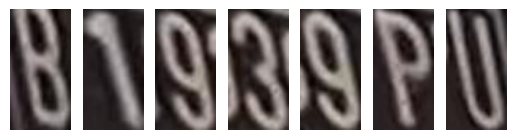

final answer: B1939PU
END OF IMAGE-53 ========== 



PREDICTING IMAGE-54 ==========
ori image


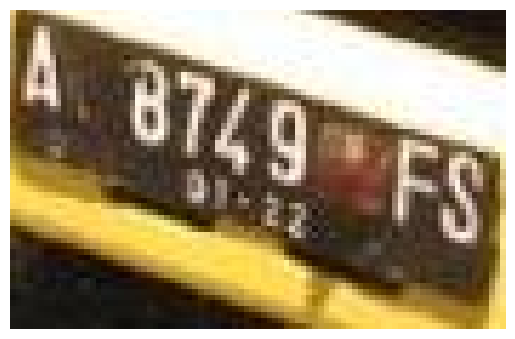

localized image


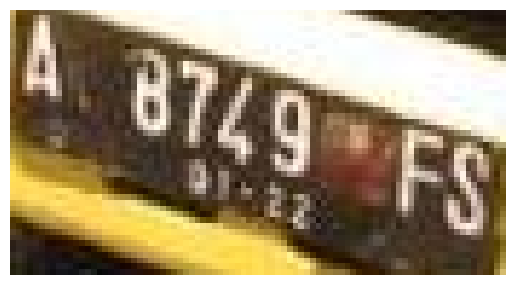


0: 160x256 7 texts, 70.5ms
Speed: 1.0ms preprocess, 70.5ms inference, 0.8ms postprocess per image at shape (1, 3, 160, 256)


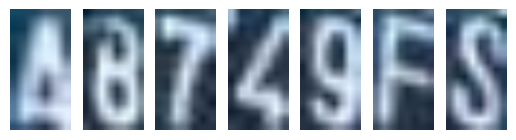

final answer: A8749FS
END OF IMAGE-54 ========== 



PREDICTING IMAGE-55 ==========
ori image


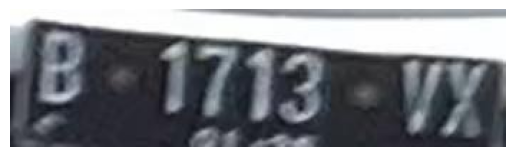

localized image


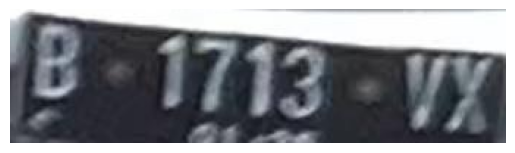


0: 96x256 7 texts, 65.0ms
Speed: 0.7ms preprocess, 65.0ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


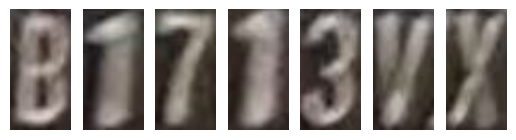

final answer: B1713VX
END OF IMAGE-55 ========== 



PREDICTING IMAGE-56 ==========
ori image


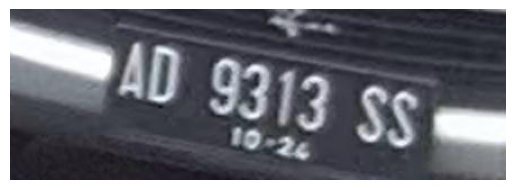

localized image


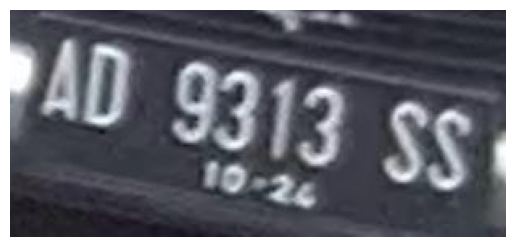


0: 128x256 8 texts, 45.2ms
Speed: 10.0ms preprocess, 45.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


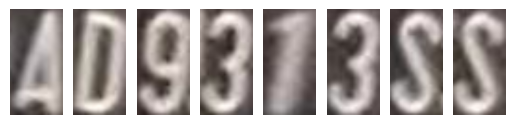

final answer: AD9313SS
END OF IMAGE-56 ========== 



PREDICTING IMAGE-57 ==========
ori image


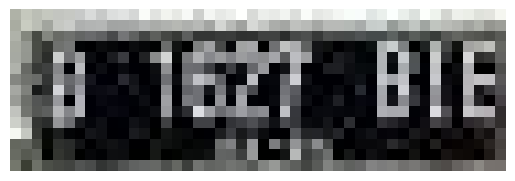

localized image


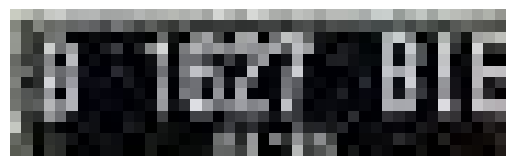


0: 96x256 8 texts, 51.0ms
Speed: 0.7ms preprocess, 51.0ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


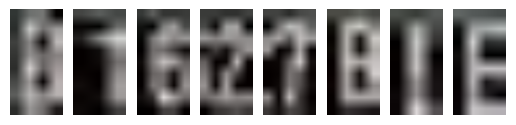

final answer: A1621B1E
END OF IMAGE-57 ========== 



PREDICTING IMAGE-58 ==========
ori image


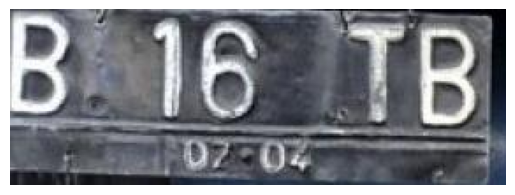

localized image


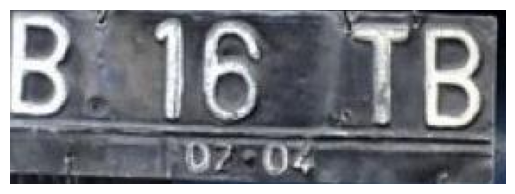


0: 96x256 5 texts, 41.6ms
Speed: 1.2ms preprocess, 41.6ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


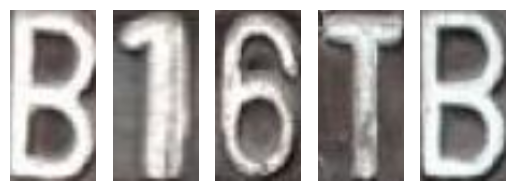

final answer: B16TB
END OF IMAGE-58 ========== 



PREDICTING IMAGE-59 ==========
ori image


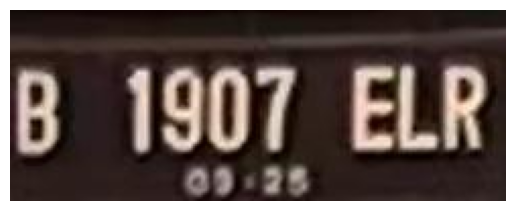

localized image


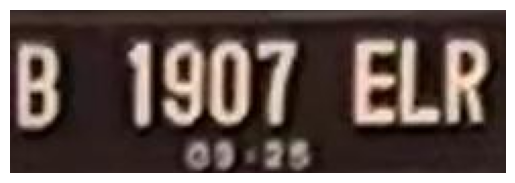


0: 96x256 8 texts, 52.7ms
Speed: 0.7ms preprocess, 52.7ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


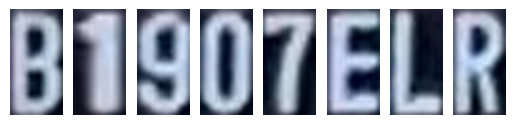

final answer: B1907ELR
END OF IMAGE-59 ========== 



PREDICTING IMAGE-60 ==========
ori image


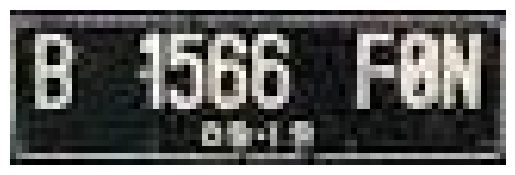

localized image


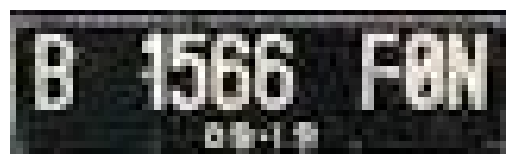


0: 96x256 8 texts, 48.7ms
Speed: 1.2ms preprocess, 48.7ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


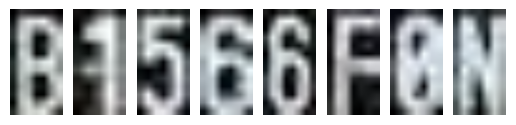

final answer: B1566FON
END OF IMAGE-60 ========== 



PREDICTING IMAGE-61 ==========
ori image


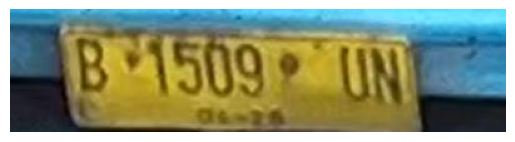

localized image


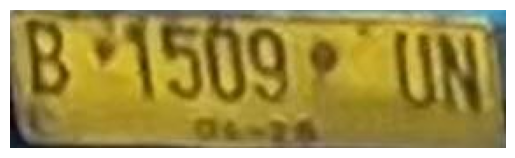


0: 96x256 7 texts, 44.9ms
Speed: 0.7ms preprocess, 44.9ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


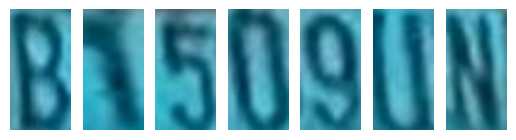

final answer: B1509UN
END OF IMAGE-61 ========== 



PREDICTING IMAGE-62 ==========
ori image


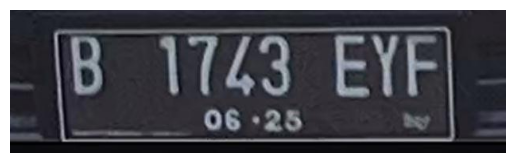

localized image


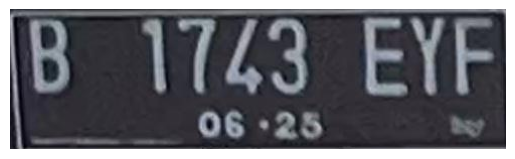


0: 96x256 8 texts, 48.5ms
Speed: 0.8ms preprocess, 48.5ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


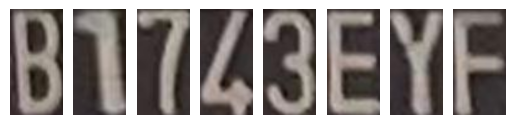

final answer: B1743EYF
END OF IMAGE-62 ========== 



PREDICTING IMAGE-63 ==========
ori image


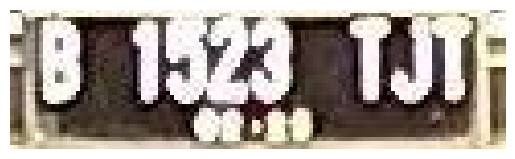

localized image


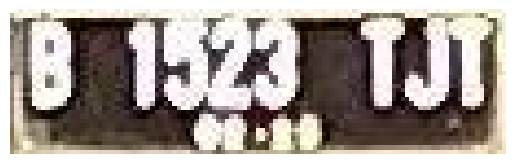


0: 96x256 8 texts, 46.9ms
Speed: 0.6ms preprocess, 46.9ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


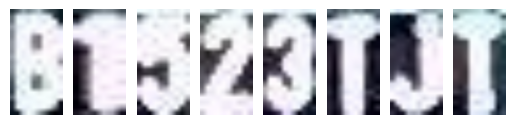

final answer: B1523TJT
END OF IMAGE-63 ========== 



PREDICTING IMAGE-64 ==========
ori image


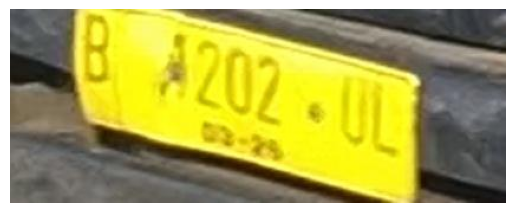

localized image


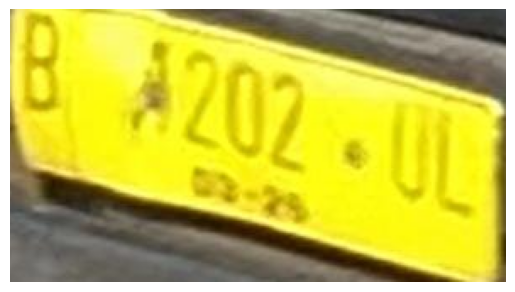


0: 160x256 3 texts, 48.1ms
Speed: 0.9ms preprocess, 48.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 256)


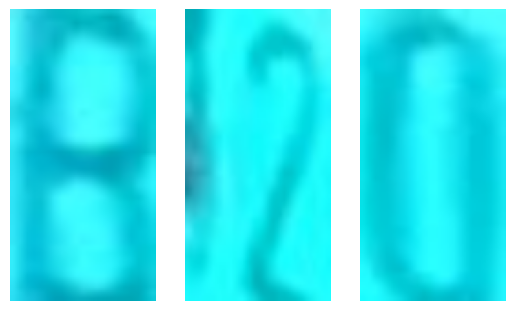

final answer: 822
END OF IMAGE-64 ========== 



PREDICTING IMAGE-65 ==========
ori image


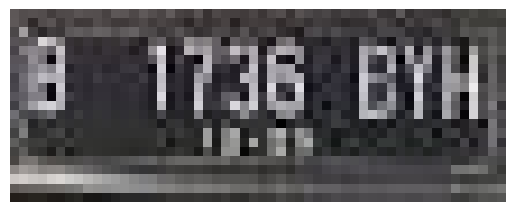

localized image


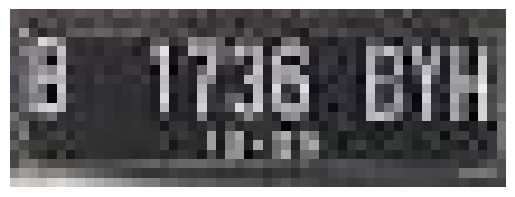


0: 96x256 8 texts, 53.9ms
Speed: 0.6ms preprocess, 53.9ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


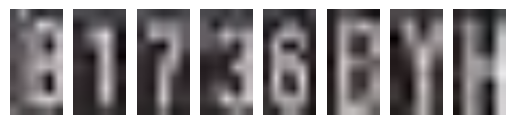

final answer: 81736BYH
END OF IMAGE-65 ========== 



PREDICTING IMAGE-66 ==========
ori image


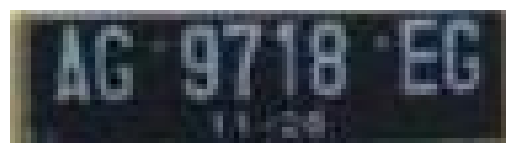

localized image


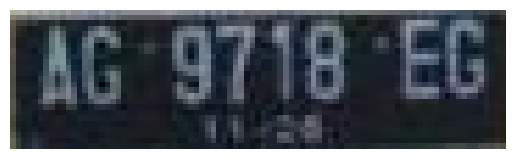


0: 96x256 8 texts, 58.6ms
Speed: 0.6ms preprocess, 58.6ms inference, 1.3ms postprocess per image at shape (1, 3, 96, 256)


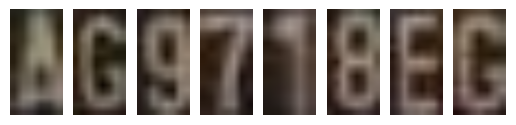

final answer: AG9718EG
END OF IMAGE-66 ========== 



PREDICTING IMAGE-67 ==========
ori image


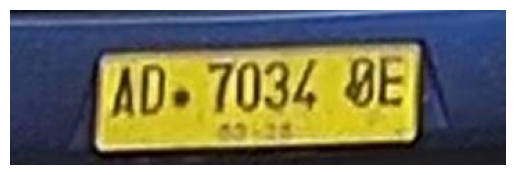

localized image


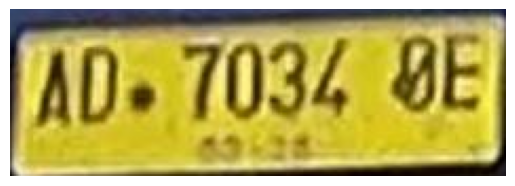


0: 96x256 8 texts, 33.9ms
Speed: 0.7ms preprocess, 33.9ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


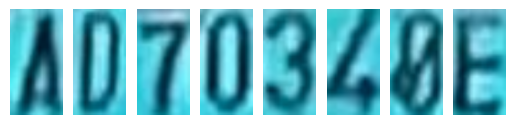

final answer: A07034OE
END OF IMAGE-67 ========== 



PREDICTING IMAGE-68 ==========
ori image


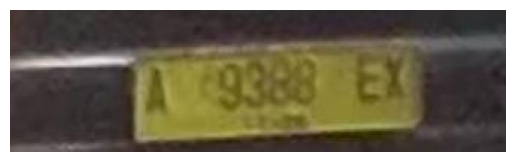

localized image


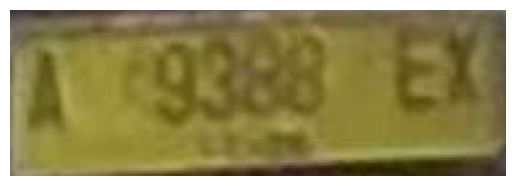


0: 96x256 6 texts, 40.1ms
Speed: 8.6ms preprocess, 40.1ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


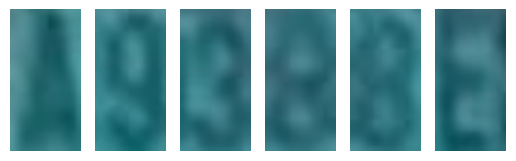

final answer: A9288E
END OF IMAGE-68 ========== 



PREDICTING IMAGE-69 ==========
ori image


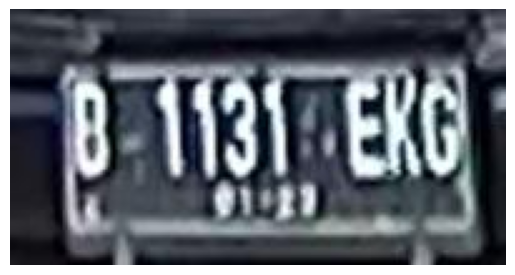

localized image


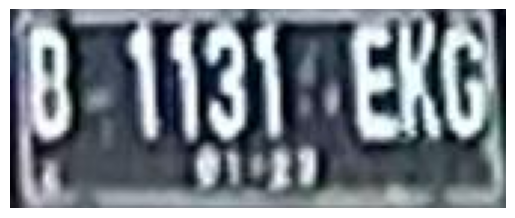


0: 128x256 8 texts, 43.1ms
Speed: 0.8ms preprocess, 43.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


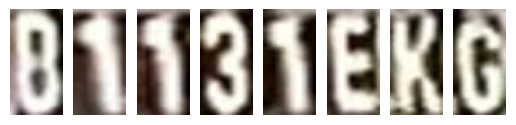

final answer: B1131EKG
END OF IMAGE-69 ========== 



PREDICTING IMAGE-70 ==========
ori image


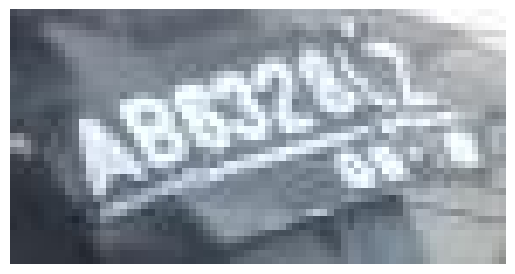

localized image


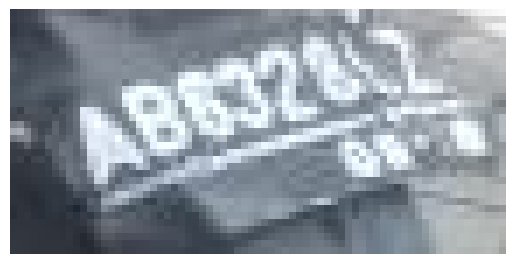


0: 128x256 6 texts, 67.8ms
Speed: 5.4ms preprocess, 67.8ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


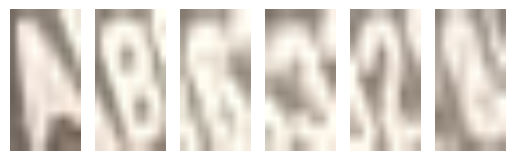

final answer: A8K22Q
END OF IMAGE-70 ========== 



PREDICTING IMAGE-71 ==========
ori image


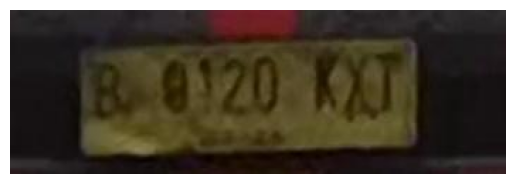

localized image


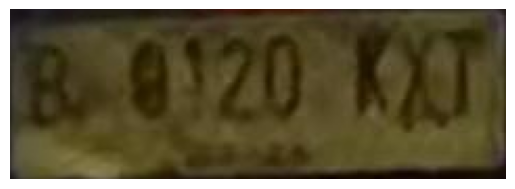


0: 96x256 6 texts, 44.5ms
Speed: 1.2ms preprocess, 44.5ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


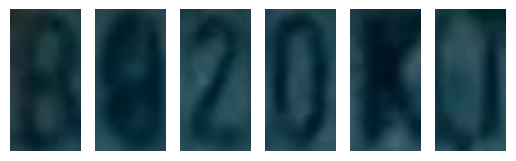

final answer: 88204Q
END OF IMAGE-71 ========== 



PREDICTING IMAGE-72 ==========
ori image


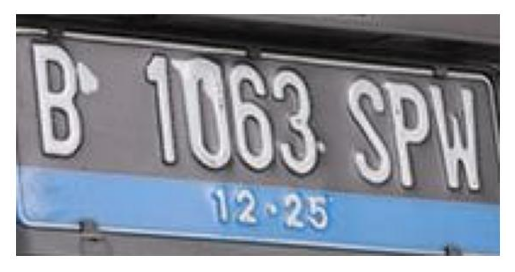

localized image


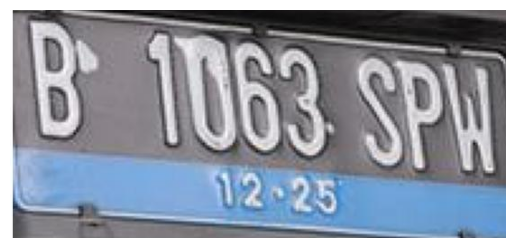


0: 128x256 8 texts, 42.4ms
Speed: 0.7ms preprocess, 42.4ms inference, 0.7ms postprocess per image at shape (1, 3, 128, 256)


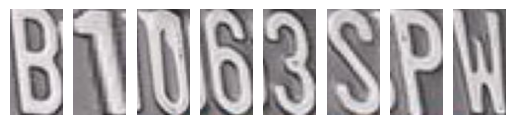

final answer: B1U63SPH
END OF IMAGE-72 ========== 



PREDICTING IMAGE-73 ==========
ori image


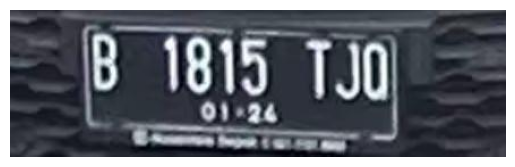

localized image


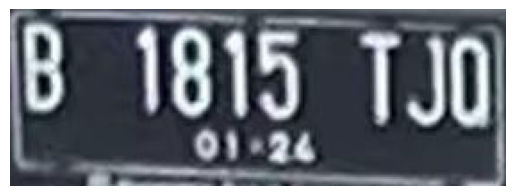


0: 96x256 8 texts, 56.7ms
Speed: 1.1ms preprocess, 56.7ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


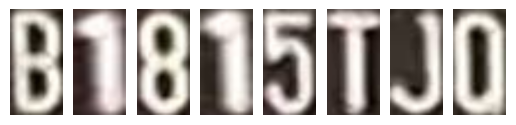

final answer: B1815TJ0
END OF IMAGE-73 ========== 



PREDICTING IMAGE-74 ==========
ori image


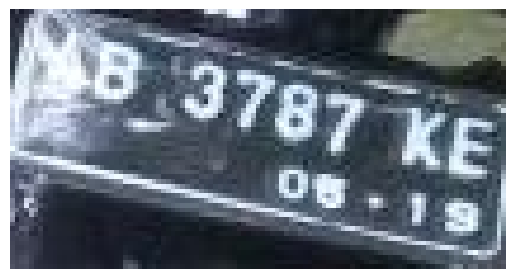

localized image


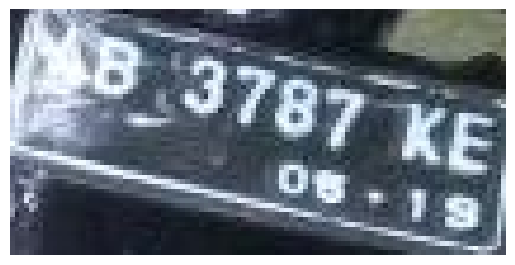


0: 128x256 9 texts, 62.5ms
Speed: 0.7ms preprocess, 62.5ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


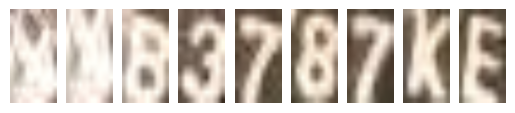

final answer: WN63787KE
END OF IMAGE-74 ========== 



PREDICTING IMAGE-75 ==========
ori image


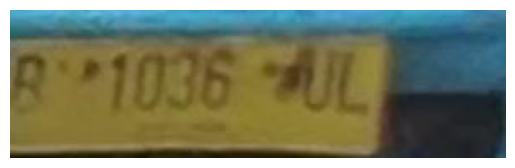

localized image


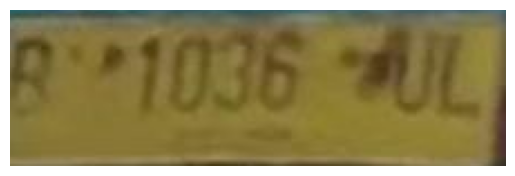


0: 96x256 8 texts, 48.7ms
Speed: 0.7ms preprocess, 48.7ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


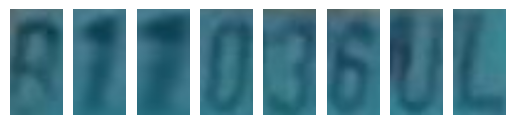

final answer: 211036UL
END OF IMAGE-75 ========== 



PREDICTING IMAGE-76 ==========
ori image


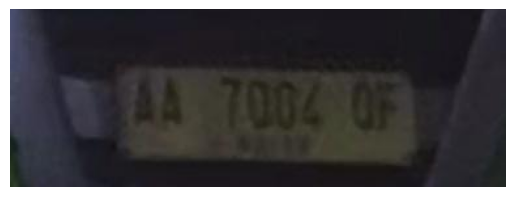

localized image


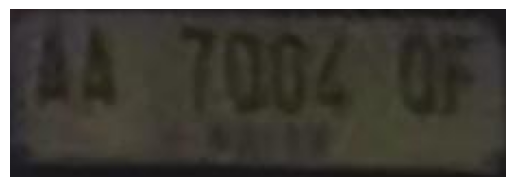


0: 96x256 8 texts, 52.0ms
Speed: 0.6ms preprocess, 52.0ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


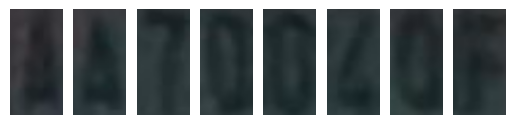

final answer: 4A700407
END OF IMAGE-76 ========== 



PREDICTING IMAGE-77 ==========
ori image


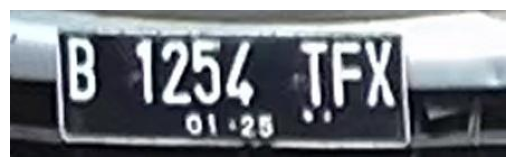

localized image


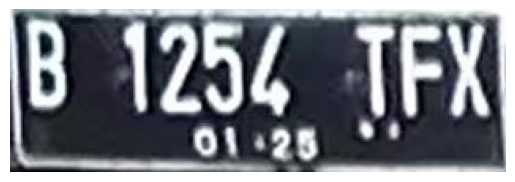


0: 96x256 8 texts, 53.5ms
Speed: 1.0ms preprocess, 53.5ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


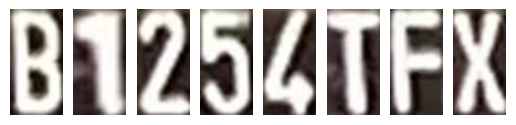

final answer: B1254TFX
END OF IMAGE-77 ========== 



PREDICTING IMAGE-78 ==========
ori image


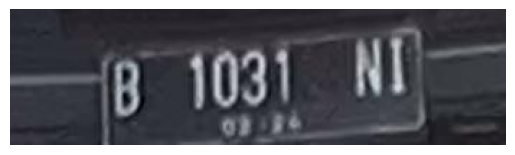

localized image


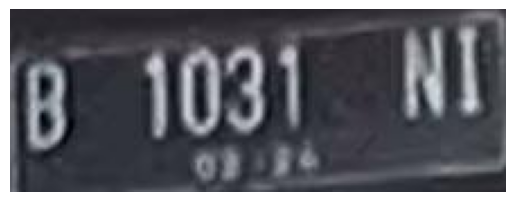


0: 96x256 7 texts, 52.0ms
Speed: 0.6ms preprocess, 52.0ms inference, 0.9ms postprocess per image at shape (1, 3, 96, 256)


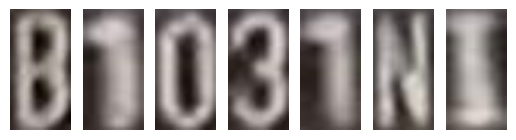

final answer: B1031NI
END OF IMAGE-78 ========== 



PREDICTING IMAGE-79 ==========
ori image


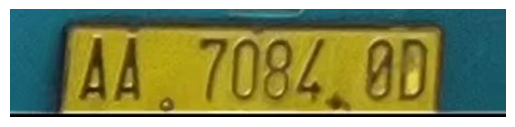

localized image


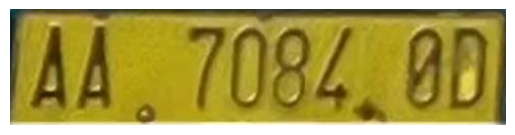


0: 64x256 8 texts, 70.0ms
Speed: 0.6ms preprocess, 70.0ms inference, 0.8ms postprocess per image at shape (1, 3, 64, 256)


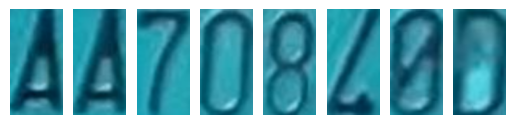

final answer: A47084OB
END OF IMAGE-79 ========== 



PREDICTING IMAGE-80 ==========
ori image


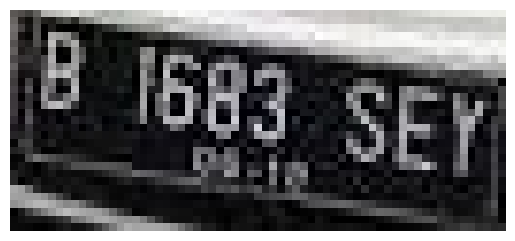

localized image


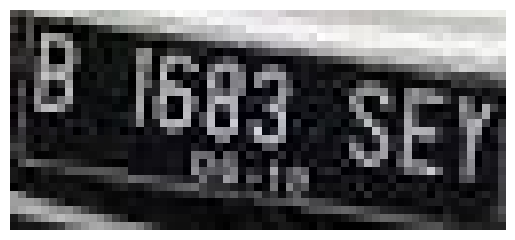


0: 128x256 8 texts, 63.2ms
Speed: 0.6ms preprocess, 63.2ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


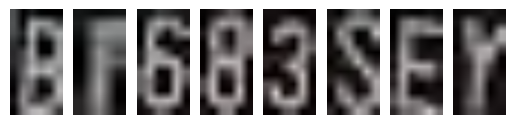

final answer: B1683SEY
END OF IMAGE-80 ========== 



PREDICTING IMAGE-81 ==========
ori image


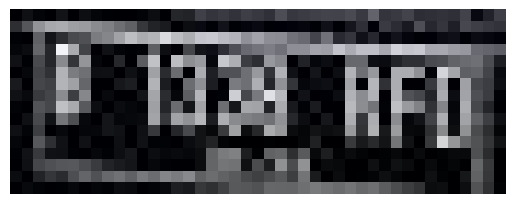

localized image


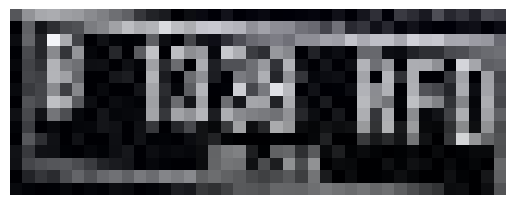


0: 96x256 8 texts, 49.9ms
Speed: 0.6ms preprocess, 49.9ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


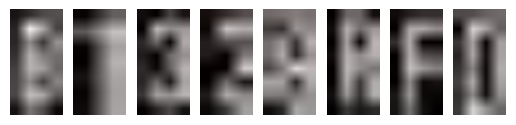

final answer: B1IJA1F1
END OF IMAGE-81 ========== 



PREDICTING IMAGE-82 ==========
ori image


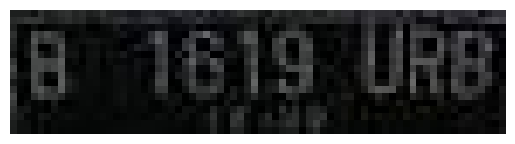

localized image


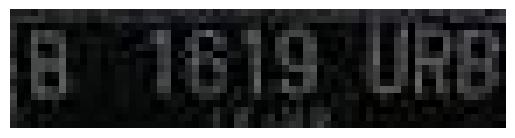


0: 64x256 8 texts, 39.7ms
Speed: 0.5ms preprocess, 39.7ms inference, 0.8ms postprocess per image at shape (1, 3, 64, 256)


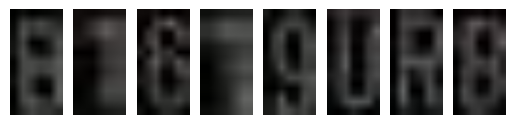

final answer: B1819UF8
END OF IMAGE-82 ========== 



PREDICTING IMAGE-83 ==========
ori image


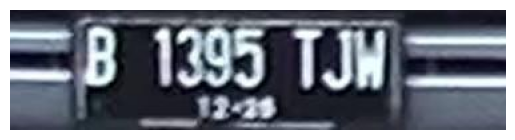

localized image


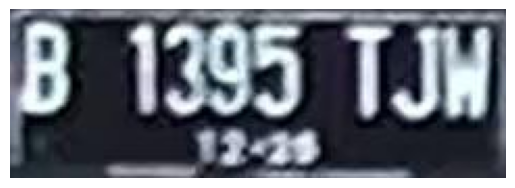


0: 96x256 8 texts, 56.1ms
Speed: 0.7ms preprocess, 56.1ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


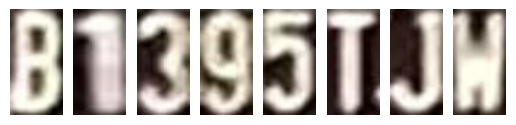

final answer: B1395TJW
END OF IMAGE-83 ========== 



PREDICTING IMAGE-84 ==========
ori image


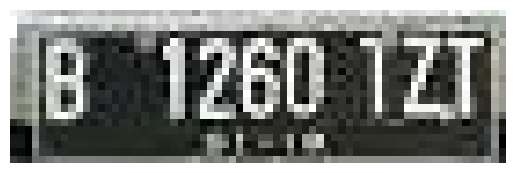

localized image


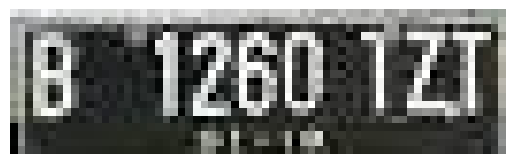


0: 96x256 8 texts, 54.3ms
Speed: 1.0ms preprocess, 54.3ms inference, 1.4ms postprocess per image at shape (1, 3, 96, 256)


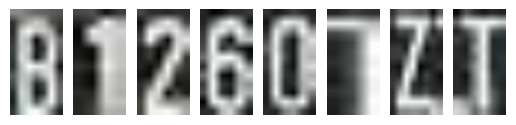

final answer: B12601ZT
END OF IMAGE-84 ========== 



PREDICTING IMAGE-85 ==========
ori image


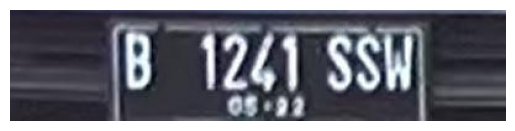

localized image


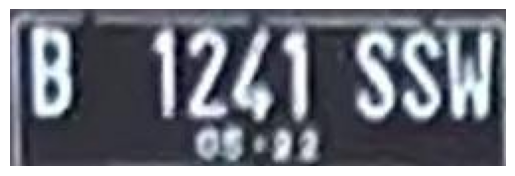


0: 96x256 8 texts, 48.5ms
Speed: 0.7ms preprocess, 48.5ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


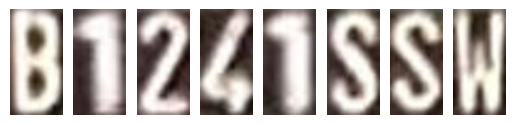

final answer: B1241SSW
END OF IMAGE-85 ========== 



PREDICTING IMAGE-86 ==========
ori image


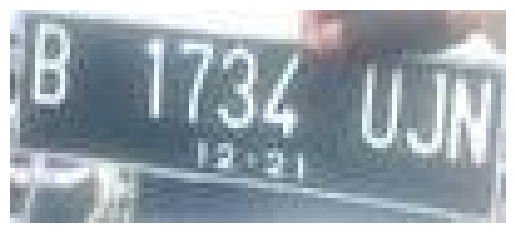

localized image


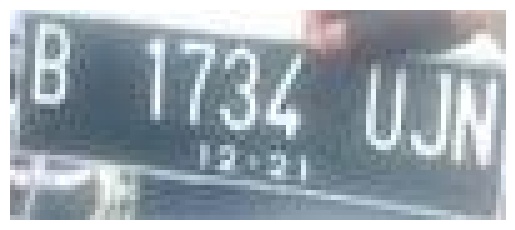


0: 128x256 8 texts, 61.1ms
Speed: 3.3ms preprocess, 61.1ms inference, 0.9ms postprocess per image at shape (1, 3, 128, 256)


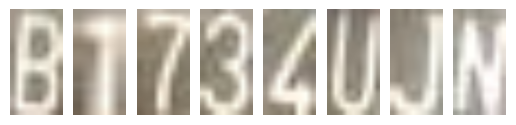

final answer: B1734UJN
END OF IMAGE-86 ========== 



PREDICTING IMAGE-87 ==========
ori image


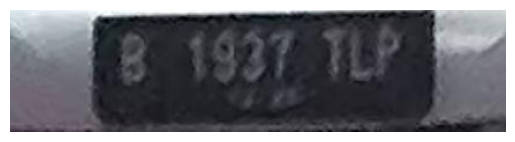

localized image


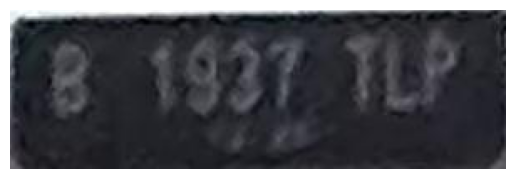


0: 96x256 8 texts, 52.7ms
Speed: 7.6ms preprocess, 52.7ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


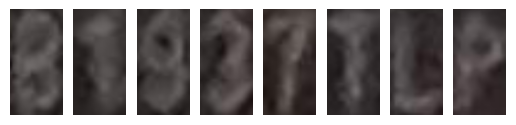

final answer: 81937TLP
END OF IMAGE-87 ========== 



PREDICTING IMAGE-88 ==========
ori image


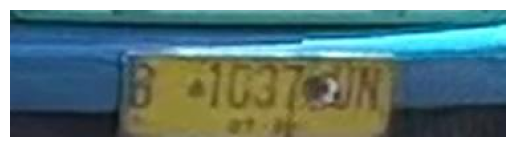

localized image


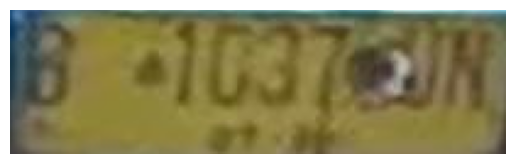


0: 96x256 6 texts, 40.7ms
Speed: 8.0ms preprocess, 40.7ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


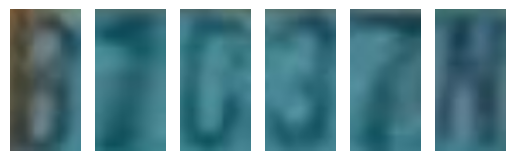

final answer: B1D37H
END OF IMAGE-88 ========== 



PREDICTING IMAGE-89 ==========
ori image


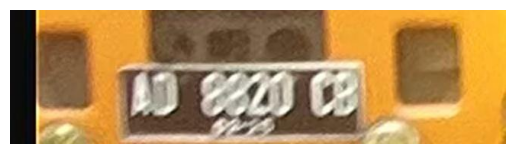

localized image


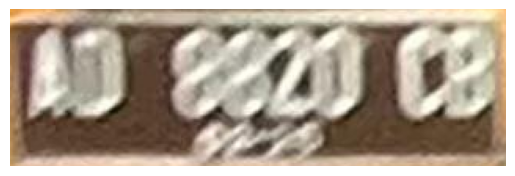


0: 96x256 6 texts, 39.2ms
Speed: 9.6ms preprocess, 39.2ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


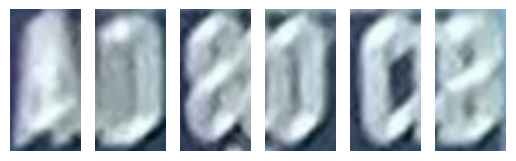

final answer: AQO0C8
END OF IMAGE-89 ========== 



PREDICTING IMAGE-90 ==========
ori image


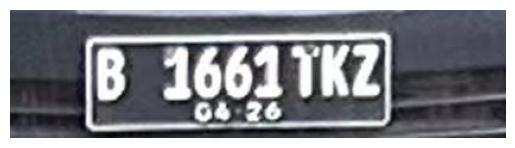

localized image


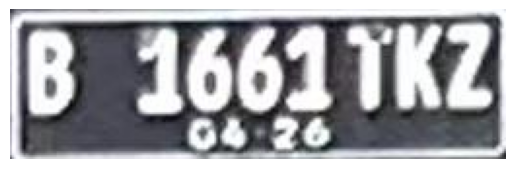


0: 96x256 8 texts, 49.4ms
Speed: 14.8ms preprocess, 49.4ms inference, 0.8ms postprocess per image at shape (1, 3, 96, 256)


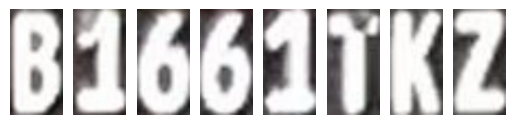

final answer: B1661TKZ
END OF IMAGE-90 ========== 



PREDICTING IMAGE-91 ==========
ori image


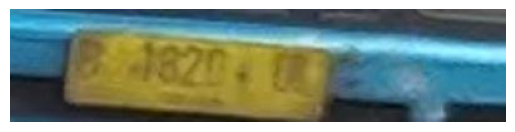

localized image


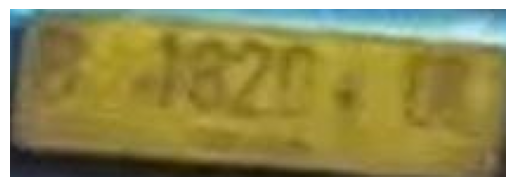


0: 96x256 5 texts, 34.3ms
Speed: 8.7ms preprocess, 34.3ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


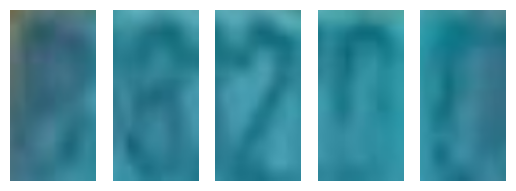

final answer: 0O222
END OF IMAGE-91 ========== 



PREDICTING IMAGE-92 ==========
ori image


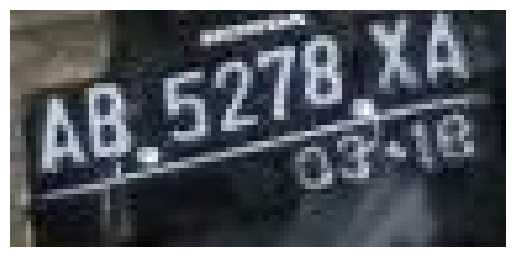

localized image


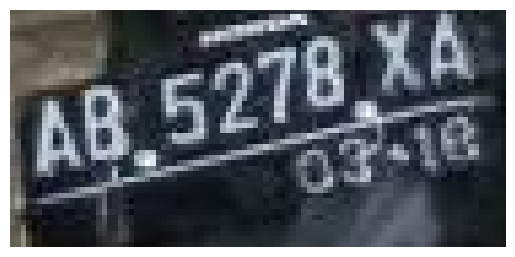


0: 128x256 9 texts, 62.3ms
Speed: 5.5ms preprocess, 62.3ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


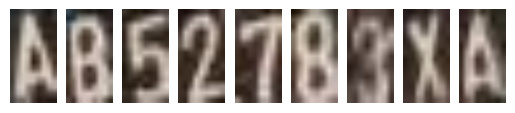

final answer: AB52783XA
END OF IMAGE-92 ========== 



PREDICTING IMAGE-93 ==========
ori image


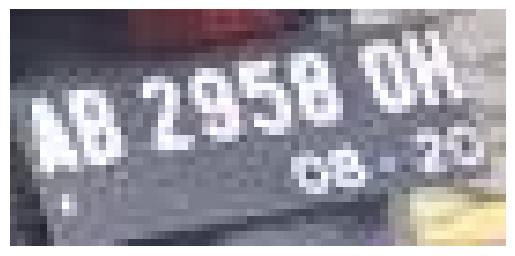

localized image


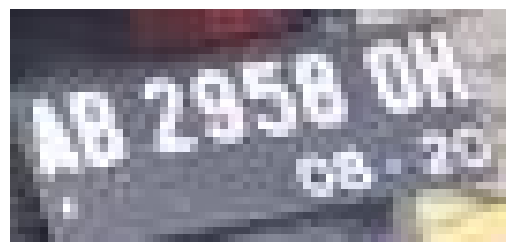


0: 128x256 8 texts, 67.5ms
Speed: 0.7ms preprocess, 67.5ms inference, 1.1ms postprocess per image at shape (1, 3, 128, 256)


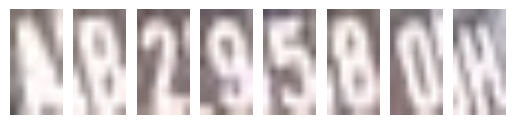

final answer: AB29580H
END OF IMAGE-93 ========== 



PREDICTING IMAGE-94 ==========
ori image


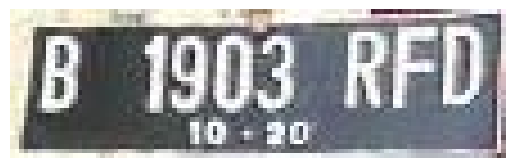

localized image


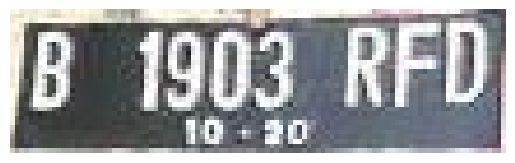


0: 96x256 8 texts, 57.0ms
Speed: 0.6ms preprocess, 57.0ms inference, 1.1ms postprocess per image at shape (1, 3, 96, 256)


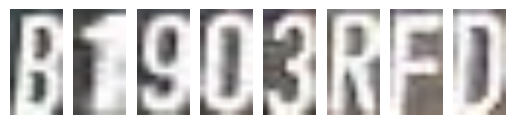

final answer: B1903RFD
END OF IMAGE-94 ========== 



PREDICTING IMAGE-95 ==========
ori image


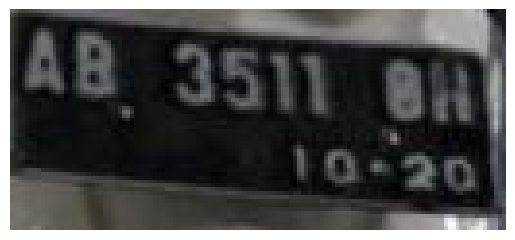

localized image


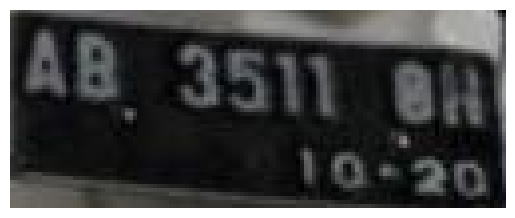


0: 128x256 8 texts, 63.9ms
Speed: 12.9ms preprocess, 63.9ms inference, 1.2ms postprocess per image at shape (1, 3, 128, 256)


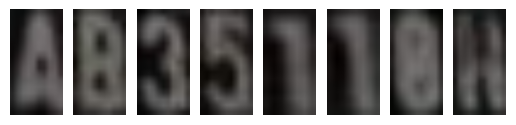

final answer: AB35118H
END OF IMAGE-95 ========== 



PREDICTING IMAGE-96 ==========
ori image


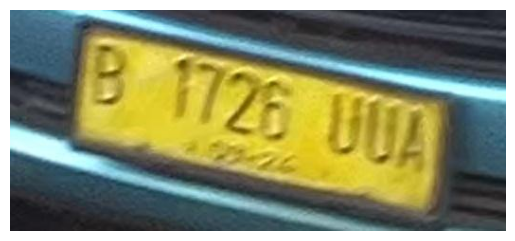

localized image


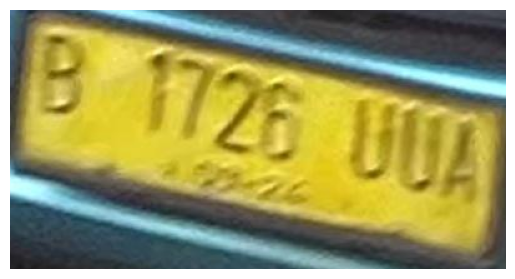


0: 160x256 8 texts, 47.1ms
Speed: 0.8ms preprocess, 47.1ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 256)


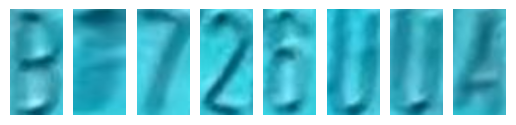

final answer: B1720UUL
END OF IMAGE-96 ========== 



PREDICTING IMAGE-97 ==========
ori image


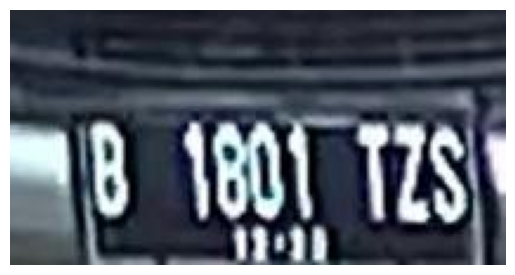

localized image


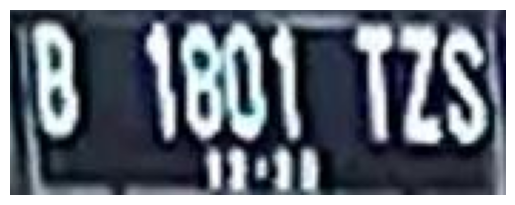


0: 96x256 8 texts, 42.7ms
Speed: 0.9ms preprocess, 42.7ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


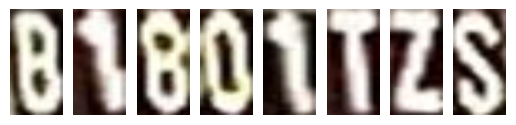

final answer: 81801TZS
END OF IMAGE-97 ========== 



PREDICTING IMAGE-98 ==========
ori image


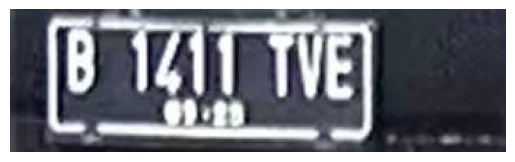

localized image


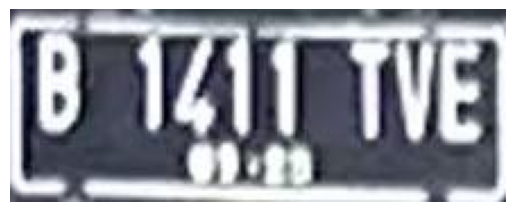


0: 128x256 8 texts, 49.1ms
Speed: 7.4ms preprocess, 49.1ms inference, 0.8ms postprocess per image at shape (1, 3, 128, 256)


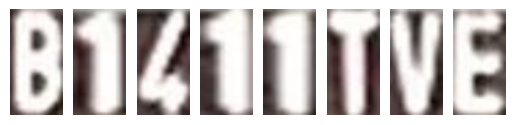

final answer: B1411TVE
END OF IMAGE-98 ========== 



PREDICTING IMAGE-99 ==========
ori image


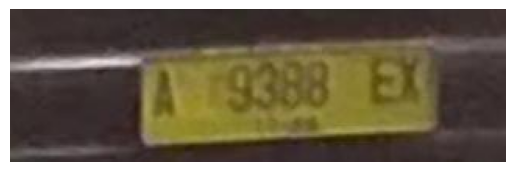

localized image


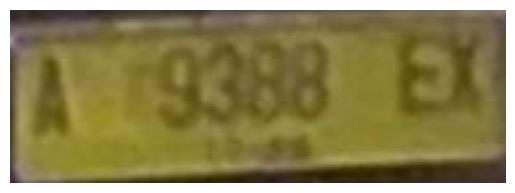


0: 96x256 6 texts, 42.5ms
Speed: 0.7ms preprocess, 42.5ms inference, 0.7ms postprocess per image at shape (1, 3, 96, 256)


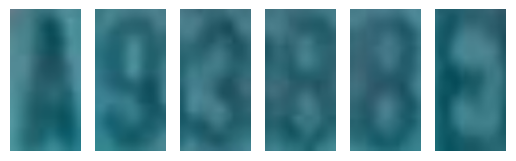

final answer: H9388E
END OF IMAGE-99 ========== 





In [43]:
### =============
### LP Localization
### =============

import cv2
import os

class_names = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']

image_dir_test = '/kaggle/working/dataset/data-modified-resized/test/data'
image_paths_test = [os.path.join(image_dir_test, f) for f in os.listdir(image_dir_test) if f.endswith('.jpg')]
print('total data: ', len(image_paths_test))

# image_paths_train = [img_test_path]

# Run batched inference on a list of images
results = lp_model(image_paths_test)  # return a list of Results objects

files = []
answers = []

# Process results list
for i, result in enumerate(results):
    
    files.append(image_paths_test[i])
    
    print(f'PREDICTING IMAGE-{i}','='*10)
    
    box = result.boxes[0].xyxy[0]  # Boxes object for bbox outputs
    box = box.detach().cpu().numpy().astype(int)
    
    # Load the original image
    image = cv2.imread(image_paths_test[i])

    # Get the bounding box coordinates
    x1, y1, x2, y2 = box

    # Crop the image using the bounding box coordinates
    cropped_image = image[y1:y2, x1:x2]
    
    # Display the cropped image
    print('ori image')
    plot_image(image)
    print('localized image')
    plot_image(cropped_image)

    
    ### =============
    ### SEGMENTATION
    ### =============
    
    img_localized = cropped_image.copy()

    segment_result = segment_model(img_localized)  # return a list of Results objects

    # Get the bounding boxes for each detected object
    boxes = segment_result[0].boxes

    tensor_boxes = boxes.xyxy
    images = []
    
    max_height = 0
    space_width = 10 # Width of the space between images in pixels
    space_color = (255, 255, 255) # Color of the space between images (white)

    # Sort the tensor_boxes by their x-coordinates
    tensor_boxes = sorted(tensor_boxes, key=lambda box: box[0])
    
    answer = ''
    
    n_images = len(tensor_boxes)
    
    ### Create a new figure for each set of segmented images ###
#     fig, axes = plt.subplots(1, n_images)
    
    recognition_img = []
    
    for j, box in enumerate(tensor_boxes):
        box = box.detach().cpu().numpy().astype(int)

        # Get the bounding box coordinates
        x1, y1, x2, y2 = box

        # Crop the image using the bounding box coordinates
        cropped_image = img_localized[y1:y2, x1:x2]

        
        ### =============
        ### RECOGNITION
        ### =============
        image_tf = tf.convert_to_tensor(cropped_image)
        image_tf, _ = load_and_preprocess_image(image_tf)

        # Preprocess the image
        image_tf = tf.convert_to_tensor(cropped_image)
        image_tf, _ = load_and_preprocess_image(image_tf)

        # Convert the preprocessed image to a numpy array
        image_np = image_tf.numpy().astype('uint8')
        recognition_img.append(image_np)
        
        # Expand the first dimension of the image tensor to create a batch of size 1
        image_tf = tf.expand_dims(image_tf, axis=0)

        # Make a prediction
        prediction = cr_model.predict(image_tf, verbose=0)
        result = class_names[np.argmax(prediction)]

        answer += result

    plot_images_horizontally(recognition_img)
        
    print(f'final answer: {answer}')
    
    answers.append(answer)
    
    print(f'END OF IMAGE-{i}','='*10, '\n\n\n')